In [2]:
!pip install -U albumentations

     |████████████████████████████████| 81kB 5.8MB/s 
     |████████████████████████████████| 37.6MB 80kB/s 
     |████████████████████████████████| 952kB 69.0MB/s 
  Found existing installation: imgaug 0.2.9
    Uninstalling imgaug-0.2.9:
      Successfully uninstalled imgaug-0.2.9
  Found existing installation: albumentations 0.1.12
    Uninstalling albumentations-0.1.12:
      Successfully uninstalled albumentations-0.1.12


In [3]:
import torch
from torch.autograd import Variable
import torch.nn as nn
import torchvision
from torchvision import models
import torch.nn.functional as F
import torch.optim as optim
from torch.optim import lr_scheduler
import torchvision.transforms as standard_transforms
import torchvision.transforms.functional as TF
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils
import albumentations as A
import albumentations.augmentations.functional as FA
from albumentations.pytorch import ToTensorV2
from skimage import io, transform, color
import numpy as np
import random
import math
import glob
import cv2
import os
import shutil
import matplotlib.pyplot as plt
from PIL import Image
from IPython.display import clear_output

In [4]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Data preparation

In [5]:
# Clear folder for images
if os.path.exists('/content/images'):
    shutil.rmtree('/content/images')
os.mkdir('/content/images')
# Copy images to colab space
images_path = '/content/drive/MyDrive/Datasets/docs/orig'
for i, filename in enumerate(sorted(os.listdir(images_path))):
    src = os.path.join(images_path, filename)
    dst = os.path.join('/content/images/', str(i) + '.jpg')
    shutil.copy(src=src, dst=dst)

# Clear folder for masks
if os.path.exists('/content/masks'):
    shutil.rmtree('/content/masks')
os.mkdir('/content/masks')
# Copy masks to colab space
masks_path = '/content/drive/MyDrive/Datasets/docs/segm'
for i, filename in enumerate(sorted(os.listdir(masks_path))):
    src = os.path.join(masks_path, filename)
    dst = os.path.join('/content/masks/', str(i) + '.jpg')
    shutil.copy(src=src, dst=dst)
# Checking
print(len(os.listdir('/content/images')), len(os.listdir('/content/masks')))

249 249


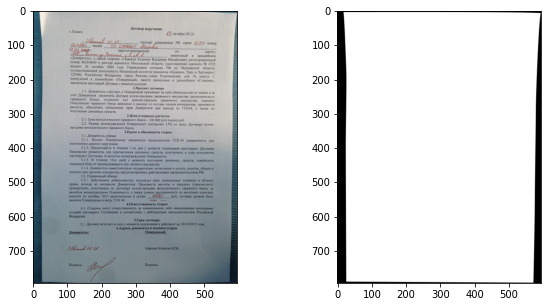

In [6]:
# Take a look at data examples
images_dir = '/content/images'
masks_dir = '/content/masks'

images_len = len(os.listdir(images_dir))
ind = np.random.randint(images_len)

fig, ax = plt.subplots(1, 2, figsize=(10, 5))

img = cv2.imread(os.path.join(images_dir, str(ind)+'.jpg'))
mask = cv2.imread(os.path.join(masks_dir, str(ind)+'.jpg'))

ax[0].imshow(img)
ax[1].imshow(mask, plt.cm.gray)
plt.show()

In [7]:
# Set global parameters
FILENAMES = np.arange(images_len)
train_indices = np.expand_dims(FILENAMES[:int(images_len*0.8)], axis=-1)
val_indices = np.expand_dims(FILENAMES[int(images_len*0.8):], axis=-1)

BATCH_SIZE = 4

INPUT_SHAPE = 512

startpoints_set = [[[30,0], [482,0], [0,512], [512,512]],
                   [[0,0], [512,0], [30,512], [482,512]],
                   [[0,30], [512,0], [0,482], [512,512]],
                   [[0,0], [512,30], [0,512], [512,482]]]
endpoints_set = [[[0,0], [512,0], [0,512], [512,512]],
                   [[0,0], [512,0], [0,512], [512,512]],
                   [[0,0], [512,0], [0,512], [512,512]],
                   [[0,0], [512,0], [0,512], [512,512]]]

In [8]:
print(len(train_indices))

199


In [9]:
def perspective_transform(img, mask):
    """ perspective transformation for data augmentation """
    transform_var = int(np.random.uniform(4))
    startpoints = np.float32(startpoints_set[transform_var])
    endpoints = np.float32(endpoints_set[transform_var])
    M = cv2.getPerspectiveTransform(startpoints, endpoints)

    img = cv2.warpPerspective(img, M, (INPUT_SHAPE, INPUT_SHAPE))
    mask = cv2.warpPerspective(mask, M, (INPUT_SHAPE, INPUT_SHAPE))

    return img, mask

In [10]:
class CustomDataset(Dataset):
  def __init__(self, image_dir, mask_dir, dataset_indices, train=False, transform=None):
    self.mask_dir = mask_dir  # Directory for folder with masks
    self.image_dir = image_dir # Directory for folder with images
    self.dataset_indices = dataset_indices  # Dataset indices
    self.transform = transform  # Image augmentation transformations
    self.train = train


  def __len__(self):
    return len(self.dataset_indices)


  def __getitem__(self, idx):

    # Generate filenames
    image_filename = os.path.join(self.image_dir, str(int(self.dataset_indices[idx])) + '.jpg')
    mask_filename = os.path.join(self.mask_dir, str(int(self.dataset_indices[idx])) + '.jpg')

    # Load image and mask
    img = cv2.imread(image_filename)
    img = img[:,:,::-1].astype(np.uint8)
    mask = cv2.imread(mask_filename)[:,:,0]
    # Resize for model input
    img = cv2.resize(img, (INPUT_SHAPE, INPUT_SHAPE), interpolation=cv2.INTER_AREA)
    mask = cv2.resize(mask, (INPUT_SHAPE, INPUT_SHAPE), interpolation=cv2.INTER_AREA)
    # Perspective transformation
    if self.train:
        if np.random.rand() > 0.5:
            img, mask = perspective_transform(img, mask)

    mask = np.expand_dims(np.clip(mask, 0, 1), axis=-1).astype(np.float32)
    # Augmentation
    if self.transform:
      transformed = self.transform(image=img, mask=mask)
      img = transformed['image']
      mask = transformed['mask']

    data = {'I': img, 'M':mask}

    return data

In [11]:
# U2Net

class REBNCONV(nn.Module):
  def __init__(self, in_ch=3, out_ch=3, dirate=1):
    super(REBNCONV, self).__init__()

    self.conv_s1 = nn.Conv2d(in_ch, out_ch, 3, padding=1*dirate, dilation=1*dirate)
    self.bn_s1 = nn.BatchNorm2d(out_ch)
    self.relu_s1 = nn.ReLU(inplace=True)

  def forward(self, x):
    x_in = x
    x_out = self.relu_s1(self.bn_s1(self.conv_s1(x_in)))

    return x_out



def _upsample_like(src, tar):
  size = tar.shape[2:]
  src = torch.nn.functional.interpolate(src, size, mode='bilinear', align_corners=False)
  return src



class RSU7(nn.Module):

  def __init__(self, in_ch=3, mid_ch=12, out_ch=3):
    super(RSU7, self).__init__()

    self.rebnconvin = REBNCONV(in_ch, out_ch, dirate=1)

    self.rebnconv1 = REBNCONV(out_ch, mid_ch, dirate=1)
    self.pool1 = nn.MaxPool2d(2, stride=2, ceil_mode=True)

    self.rebnconv2 = REBNCONV(mid_ch, mid_ch, dirate=1)
    self.pool2 = nn.MaxPool2d(2, stride=2, ceil_mode=True)

    self.rebnconv3 = REBNCONV(mid_ch, mid_ch, dirate=1)
    self.pool3 = nn.MaxPool2d(2, stride=2, ceil_mode=True)

    self.rebnconv4 = REBNCONV(mid_ch, mid_ch, dirate=1)
    self.pool4 = nn.MaxPool2d(2, stride=2, ceil_mode=True)

    self.rebnconv5 = REBNCONV(mid_ch, mid_ch, dirate=1)
    self.pool5 = nn.MaxPool2d(2, stride=2, ceil_mode=True)

    self.rebnconv6 = REBNCONV(mid_ch, mid_ch, dirate=1)

    self.rebnconv7 = REBNCONV(mid_ch, mid_ch, dirate=2)

    self.rebnconv6d = REBNCONV(2*mid_ch, mid_ch, dirate=1)
    self.rebnconv5d = REBNCONV(2*mid_ch, mid_ch, dirate=1)
    self.rebnconv4d = REBNCONV(2*mid_ch, mid_ch, dirate=1)
    self.rebnconv3d = REBNCONV(2*mid_ch, mid_ch, dirate=1)
    self.rebnconv2d = REBNCONV(2*mid_ch, mid_ch, dirate=1)
    self.rebnconv1d = REBNCONV(2*mid_ch, out_ch, dirate=1)
    
  def forward(self, x):

    x_in = x

    x_in = self.rebnconvin(x_in)

    x_1 = self.rebnconv1(x_in)
    x = self.pool1(x_1)

    x_2 = self.rebnconv2(x)
    x = self.pool2(x_2)

    x_3 = self.rebnconv3(x)
    x = self.pool3(x_3)

    x_4 = self.rebnconv4(x)
    x = self.pool4(x_4)

    x_5 = self.rebnconv5(x)
    x = self.pool5(x_5)

    x_6 = self.rebnconv6(x)

    x_7 = self.rebnconv7(x_6)

    x_6d = self.rebnconv6d(torch.cat((x_7, x_6), 1))
    x_6_up = _upsample_like(x_6d, x_5)

    x_5d = self.rebnconv5d(torch.cat((x_6_up, x_5), 1))
    x_5_up = _upsample_like(x_5d, x_4)

    x_4d = self.rebnconv4d(torch.cat((x_5_up, x_4), 1))
    x_4_up = _upsample_like(x_4d, x_3)

    x_3d = self.rebnconv3d(torch.cat((x_4_up, x_3), 1))
    x_3_up = _upsample_like(x_3d, x_2)

    x_2d = self.rebnconv2d(torch.cat((x_3_up, x_2), 1))
    x_2_up = _upsample_like(x_2d, x_1)

    x_1d = self.rebnconv1d(torch.cat((x_2_up, x_1), 1))

    return x_1d + x_in



class RSU6(nn.Module):

  def __init__(self, in_ch=3, mid_ch=12, out_ch=3):
    super(RSU6, self).__init__()

    self.rebnconvin = REBNCONV(in_ch, out_ch, dirate=1)

    self.rebnconv1 = REBNCONV(out_ch, mid_ch, dirate=1)
    self.pool1 = nn.MaxPool2d(2, stride=2, ceil_mode=True)

    self.rebnconv2 = REBNCONV(mid_ch, mid_ch, dirate=1)
    self.pool2 = nn.MaxPool2d(2, stride=2, ceil_mode=True)

    self.rebnconv3 = REBNCONV(mid_ch, mid_ch, dirate=1)
    self.pool3 = nn.MaxPool2d(2, stride=2, ceil_mode=True)

    self.rebnconv4 = REBNCONV(mid_ch, mid_ch, dirate=1)
    self.pool4 = nn.MaxPool2d(2, stride=2, ceil_mode=True)

    self.rebnconv5 = REBNCONV(mid_ch, mid_ch, dirate=1)

    self.rebnconv6 = REBNCONV(mid_ch, mid_ch, dirate=2)

    self.rebnconv5d = REBNCONV(2*mid_ch, mid_ch, dirate=1)
    self.rebnconv4d = REBNCONV(2*mid_ch, mid_ch, dirate=1)
    self.rebnconv3d = REBNCONV(2*mid_ch, mid_ch, dirate=1)
    self.rebnconv2d = REBNCONV(2*mid_ch, mid_ch, dirate=1)
    self.rebnconv1d = REBNCONV(2*mid_ch, out_ch, dirate=1)
    
  def forward(self, x):

    x_in = x

    x_in = self.rebnconvin(x_in)

    x_1 = self.rebnconv1(x_in)
    x = self.pool1(x_1)

    x_2 = self.rebnconv2(x)
    x = self.pool2(x_2)

    x_3 = self.rebnconv3(x)
    x = self.pool3(x_3)

    x_4 = self.rebnconv4(x)
    x = self.pool4(x_4)

    x_5 = self.rebnconv5(x)

    x_6 = self.rebnconv6(x_5)

    x_5d = self.rebnconv5d(torch.cat((x_6, x_5), 1))
    x_5_up = _upsample_like(x_5d, x_4)

    x_4d = self.rebnconv4d(torch.cat((x_5_up, x_4), 1))
    x_4_up = _upsample_like(x_4d, x_3)

    x_3d = self.rebnconv3d(torch.cat((x_4_up, x_3), 1))
    x_3_up = _upsample_like(x_3d, x_2)

    x_2d = self.rebnconv2d(torch.cat((x_3_up, x_2), 1))
    x_2_up = _upsample_like(x_2d, x_1)

    x_1d = self.rebnconv1d(torch.cat((x_2_up, x_1), 1))

    return x_1d + x_in



class RSU5(nn.Module):

  def __init__(self, in_ch=3, mid_ch=12, out_ch=3):
    super(RSU5, self).__init__()

    self.rebnconvin = REBNCONV(in_ch, out_ch, dirate=1)

    self.rebnconv1 = REBNCONV(out_ch, mid_ch, dirate=1)
    self.pool1 = nn.MaxPool2d(2, stride=2, ceil_mode=True)

    self.rebnconv2 = REBNCONV(mid_ch, mid_ch, dirate=1)
    self.pool2 = nn.MaxPool2d(2, stride=2, ceil_mode=True)

    self.rebnconv3 = REBNCONV(mid_ch, mid_ch, dirate=1)
    self.pool3 = nn.MaxPool2d(2, stride=2, ceil_mode=True)

    self.rebnconv4 = REBNCONV(mid_ch, mid_ch, dirate=1)

    self.rebnconv5 = REBNCONV(mid_ch, mid_ch, dirate=2)

    self.rebnconv4d = REBNCONV(2*mid_ch, mid_ch, dirate=1)
    self.rebnconv3d = REBNCONV(2*mid_ch, mid_ch, dirate=1)
    self.rebnconv2d = REBNCONV(2*mid_ch, mid_ch, dirate=1)
    self.rebnconv1d = REBNCONV(2*mid_ch, out_ch, dirate=1)
    
  def forward(self, x):

    x_in = x

    x_in = self.rebnconvin(x_in)

    x_1 = self.rebnconv1(x_in)
    x = self.pool1(x_1)

    x_2 = self.rebnconv2(x)
    x = self.pool2(x_2)

    x_3 = self.rebnconv3(x)
    x = self.pool3(x_3)

    x_4 = self.rebnconv4(x)

    x_5 = self.rebnconv5(x_4)

    x_4d = self.rebnconv4d(torch.cat((x_5, x_4), 1))
    x_4_up = _upsample_like(x_4d, x_3)

    x_3d = self.rebnconv3d(torch.cat((x_4_up, x_3), 1))
    x_3_up = _upsample_like(x_3d, x_2)

    x_2d = self.rebnconv2d(torch.cat((x_3_up, x_2), 1))
    x_2_up = _upsample_like(x_2d, x_1)

    x_1d = self.rebnconv1d(torch.cat((x_2_up, x_1), 1))

    return x_1d + x_in



class RSU4(nn.Module):

  def __init__(self, in_ch=3, mid_ch=12, out_ch=3):
    super(RSU4, self).__init__()

    self.rebnconvin = REBNCONV(in_ch, out_ch, dirate=1)

    self.rebnconv1 = REBNCONV(out_ch, mid_ch, dirate=1)
    self.pool1 = nn.MaxPool2d(2, stride=2, ceil_mode=True)

    self.rebnconv2 = REBNCONV(mid_ch, mid_ch, dirate=1)
    self.pool2 = nn.MaxPool2d(2, stride=2, ceil_mode=True)

    self.rebnconv3 = REBNCONV(mid_ch, mid_ch, dirate=1)

    self.rebnconv4 = REBNCONV(mid_ch, mid_ch, dirate=2)

    self.rebnconv3d = REBNCONV(2*mid_ch, mid_ch, dirate=1)
    self.rebnconv2d = REBNCONV(2*mid_ch, mid_ch, dirate=1)
    self.rebnconv1d = REBNCONV(2*mid_ch, out_ch, dirate=1)
    
  def forward(self, x):

    x_in = x

    x_in = self.rebnconvin(x_in)

    x_1 = self.rebnconv1(x_in)
    x = self.pool1(x_1)

    x_2 = self.rebnconv2(x)
    x = self.pool2(x_2)

    x_3 = self.rebnconv3(x)

    x_4 = self.rebnconv4(x_3)

    x_3d = self.rebnconv3d(torch.cat((x_4, x_3), 1))
    x_3_up = _upsample_like(x_3d, x_2)

    x_2d = self.rebnconv2d(torch.cat((x_3_up, x_2), 1))
    x_2_up = _upsample_like(x_2d, x_1)

    x_1d = self.rebnconv1d(torch.cat((x_2_up, x_1), 1))

    return x_1d + x_in



class RSU4F(nn.Module):

  def __init__(self, in_ch=3, mid_ch=12, out_ch=3):
    super(RSU4F, self).__init__()

    self.rebnconvin = REBNCONV(in_ch, out_ch, dirate=1)

    self.rebnconv1 = REBNCONV(out_ch, mid_ch, dirate=1)
    self.rebnconv2 = REBNCONV(mid_ch, mid_ch, dirate=2)
    self.rebnconv3 = REBNCONV(mid_ch, mid_ch, dirate=4)

    self.rebnconv4  = REBNCONV(mid_ch, mid_ch, dirate=8)

    self.rebnconv3d = REBNCONV(2*mid_ch, mid_ch, dirate=4)
    self.rebnconv2d = REBNCONV(2*mid_ch, mid_ch, dirate=2)
    self.rebnconv1d = REBNCONV(2*mid_ch, out_ch, dirate=1)

  def forward(self, x):

    x_in = x
    x_in = self.rebnconvin(x_in)

    x_1 = self.rebnconv1(x_in)
    x_2 = self.rebnconv2(x_1)
    x_3 = self.rebnconv3(x_2)

    x_4 = self.rebnconv4(x_3)

    x_3d = self.rebnconv3d(torch.cat((x_4, x_3), 1))
    x_2d = self.rebnconv2d(torch.cat((x_3d, x_2), 1))
    x_1d = self.rebnconv1d(torch.cat((x_2d, x_1), 1))

    return x_1d + x_in



class U2NET(nn.Module):

  def __init__(self, in_ch=3, out_ch=1):
    super(U2NET, self).__init__()

    # Encoder
    self.stage1 = RSU7(in_ch, 32, 64)
    self.pool12 = nn.MaxPool2d(2, stride=2, ceil_mode=True)

    self.stage2 = RSU6(64, 32, 128)
    self.pool23 = nn.MaxPool2d(2, stride=2, ceil_mode=True)

    self.stage3 = RSU5(128, 64, 256)
    self.pool34 = nn.MaxPool2d(2, stride=2, ceil_mode=True)

    self.stage4 = RSU4(256, 128, 512)
    self.pool45 = nn.MaxPool2d(2, stride=2, ceil_mode=True)

    self.stage5 = RSU4F(512, 256, 512)
    self.pool56 = nn.MaxPool2d(2, stride=2, ceil_mode=True)

    self.stage6 = RSU4F(512, 256, 512)

    # Decoder
    self.stage5d = RSU4F(1024, 256, 512)
    self.stage4d = RSU4(1024, 128, 256)
    self.stage3d = RSU5(512, 64, 128)
    self.stage2d = RSU6(256, 32, 64)
    self.stage1d = RSU7(128, 16, 64)

    self.side1 = nn.Conv2d(64, out_ch, 3, padding=1)
    self.side2 = nn.Conv2d(64, out_ch, 3, padding=1)
    self.side3 = nn.Conv2d(128, out_ch, 3, padding=1)
    self.side4 = nn.Conv2d(256, out_ch, 3, padding=1)
    self.side5 = nn.Conv2d(512, out_ch, 3, padding=1)
    self.side6 = nn.Conv2d(512, out_ch, 3, padding=1)

    self.outconv = nn.Conv2d(6, out_ch, 1)


  def forward(self, x):

    # Encoder
    x_in = x

    x_1 = self.stage1(x_in)
    x = self.pool12(x_1)

    x_2 = self.stage2(x)
    x = self.pool23(x_2)

    x_3 = self.stage3(x)
    x = self.pool34(x_3)

    x_4 = self.stage4(x)
    x = self.pool45(x_4)

    x_5 = self.stage5(x)
    x = self.pool56(x_5)

    x_6 = self.stage6(x)
    x_6_up = _upsample_like(x_6, x_5)

    # Decoder
    x_5d = self.stage5d(torch.cat((x_6_up, x_5), 1))
    x_5_up = _upsample_like(x_5d, x_4)

    x_4d = self.stage4d(torch.cat((x_5_up, x_4), 1))
    x_4_up = _upsample_like(x_4d, x_3)

    x_3d = self.stage3d(torch.cat((x_4_up, x_3), 1))
    x_3_up = _upsample_like(x_3d, x_2)

    x_2d = self.stage2d(torch.cat((x_3_up, x_2), 1))
    x_2_up = _upsample_like(x_2d, x_1)

    x_1d = self.stage1d(torch.cat((x_2_up, x_1), 1))

    # Side output
    d1 = self.side1(x_1d)

    d2 = self.side2(x_2d)
    d2 = _upsample_like(d2, d1)

    d3 = self.side3(x_3d)
    d3 = _upsample_like(d3, d1)

    d4 = self.side4(x_4d)
    d4 = _upsample_like(d4, d1)

    d5 = self.side5(x_5d)
    d5 = _upsample_like(d5, d1)

    d6 = self.side6(x_6)
    d6 = _upsample_like(d6, d1)

    d0 = self.outconv(torch.cat((d1, d2, d3, d4, d5, d6), 1))

    return torch.sigmoid(d0), torch.sigmoid(d1), torch.sigmoid(d2), torch.sigmoid(d3), torch.sigmoid(d4), torch.sigmoid(d5), torch.sigmoid(d6)

In [12]:
class DocsTrainer():

  def __init__(self, dataloaders):

    self.dataloaders = dataloaders # Datasets

    self.net = U2NET(3, 1).to(device) # Neural net

    # Optimizer settings
    self.lr = LR
    self.optimizer = optim.Adam(self.net.parameters(), lr=self.lr, betas=(0.9, 0.999), eps=1e-08, weight_decay=0)
    self.lr_scheduler = lr_scheduler.StepLR(self.optimizer, step_size=10, gamma=0.9)

    self.running_acc = [] # Accuracy during epoch
    self.epoch_acc = 0  # Start epoch accuracy
    self.best_val_acc = 0.0 # Best in history accuracy value
    self.best_epoch_id = 0 # Number of best epoch
    self.epoch_to_start = 0 # Start/continue epoch
    self.max_num_epochs = EPOCHS # NUmber of epochs
    self.d0 = None 
    self.d1 = None
    self.d2 = None
    self.d3 = None
    self.d4 = None
    self.d5 = None
    self.d6 = None
    self.batch = None # Current batch
    # Loss 
    self.loss = None 
    self.loss2 = None
    # Flag for train/val
    self.is_training = False
    # Corrunt batch and epoch number
    self.batch_id = 0
    self.epoch_id = 0
    # Folders for results saving
    self.checkpoint_dir = checkpoint_dir
    self.vis_dir = vis_dir
    # Epochs history
    self.val_history = []
    self.train_history = []

    if os.path.exists(self.checkpoint_dir) is False:
      os.mkdir(self.checkpoint_dir)
    if os.path.exists(self.vis_dir) is False:
      os.mkdir(self.vis_dir)

  # Load model and information from checkpoint
  def _load_checkpoint(self):

    if os.path.exists(os.path.join(self.checkpoint_dir, 'last_ckpt.pt')):
      print('loading last checkpoint...')
      checkpoint = torch.load(os.path.join(self.checkpoint_dir, 'last_ckpt.pt'))
      self.net.load_state_dict(checkpoint['model_state_dict'])
      self.optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
      self.lr_scheduler.load_state_dict(checkpoint['lr_scheduler_state_dict'])
      self.net.to(device)

      self.epoch_to_start = checkpoint['epoch_id'] + 1
      self.best_val_acc = checkpoint['best_val_acc']
      self.best_epoch_id = checkpoint['best_epoch_id']
      self.val_history = checkpoint['val_history']
      self.train_history = checkpoint['train_history']

      print('Epoch_to_start = %d, Historical_best_acc = %.4f (at epoch %d)' %
            (self.epoch_to_start, self.best_val_acc, self.best_epoch_id))
      print()

    else:
        print('training from scratch...')

  # Save model and training information
  def _save_checkpoint(self, ckpt_name):
    torch.save({
        'epoch_id': self.epoch_id,
        'best_val_acc': self.best_val_acc,
        'best_epoch_id': self.best_epoch_id,
        'val_history': self.val_history,
        'train_history': self.train_history,
        'model_state_dict': self.net.state_dict(),
        'optimizer_state_dict': self.optimizer.state_dict(),
        'lr_scheduler_state_dict': self.lr_scheduler.state_dict(),
    }, os.path.join(self.checkpoint_dir, ckpt_name))


  def _update_lr_schedulers(self):
    self.lr_scheduler.step()

  # Dice coef metric calculation
  def _compute_acc(self):
    target = self.batch['M'].to(device).detach()
    pred = self.d0.detach()
    acc = dice_coef(pred, target)
    return acc

  # Function for current epoch results representation
  def _collect_running_batch_states(self):
    self.running_acc.append(self._compute_acc().item())


    if self.is_training:
    # Each 100 batches save results
      if np.mod(self.batch_id, 100) == 1:
        vis_input = make_numpy_grid(self.batch['I'])
        vis_pred = make_numpy_grid(self.d0)
        vis_gt = make_numpy_grid(self.batch['M'])
        vis = np.concatenate([vis_input, vis_pred, vis_gt], axis=0)
        vis = np.clip(vis, a_min=0.0, a_max=1.0)
        file_name = os.path.join(
            self.vis_dir, 'istrain_'+str(self.is_training)+'_'+
                          str(self.epoch_id)+'_'+str(self.batch_id)+'.jpg')
        plt.imsave(file_name, vis)
    else:
      if np.mod(self.batch_id, 10) == 1:
        vis_input = make_numpy_grid(self.batch['I'])
        vis_pred = make_numpy_grid(self.d0)
        vis_gt = make_numpy_grid(self.batch['M'])
        vis = np.concatenate([vis_input, vis_pred, vis_gt], axis=0)
        vis = np.clip(vis, a_min=0.0, a_max=1.0)
        file_name = os.path.join(
            self.vis_dir, 'istrain_'+str(self.is_training)+'_'+
                          str(self.epoch_id)+'_'+str(self.batch_id)+'.jpg')
        plt.imsave(file_name, vis)


  def _collect_epoch_states(self):

    self.epoch_acc = np.mean(self.running_acc)
    if self.is_training:
      self.train_history.append(self.epoch_acc)
    else:
      self.val_history.append(self.epoch_acc)


  def _update_checkpoints(self):

      clear_output()
      # save current model
      self._save_checkpoint(ckpt_name='last_ckpt.pt')

      print('Epoch %d / %d, Epoch_acc=%.4f, Historical_best_acc=%.4f (at epoch %d)'
            % (self.epoch_id, self.max_num_epochs-1, self.epoch_acc, self.best_val_acc, self.best_epoch_id))
      print()

      plt.plot(self.val_history, label='val_dice_coef')
      plt.plot(self.train_history, label='train_dice_coef')
      plt.plot(np.argmax(np.array(self.val_history)), max(self.val_history), 'go')
      plt.text(np.argmax(np.array(self.val_history))+0.2, max(self.val_history)+0.01, str(round(max(self.val_history),3)))
      plt.legend()
      plt.show()

      # update the best model (based on eval acc)
      if self.epoch_acc > self.best_val_acc:
          self.best_val_acc = self.epoch_acc
          self.best_epoch_id = self.epoch_id
          self._save_checkpoint(ckpt_name='best_ckpt.pt')
          print('*' * 10 + 'Best model updated!')
          print()


  def _clear_cache(self):
      self.running_acc = []


  def _forward_pass(self, batch):
      self.batch = batch
      img_in = batch['I'].to(device)
      self.d0, self.d1, self.d2, self.d3, self.d4, self.d5, self.d6, = self.net(img_in)


  def _backward_G(self):
      gt = self.batch['M'].to(device)
      self.loss2, self.loss = multi_bce_loss_fusion(self.d0, self.d1, self.d2, self.d3,
                                                    self.d4, self.d5, self.d6, gt)
      self.loss.backward()

  # Training funcrion
  def train_model(self):
    
    self._load_checkpoint()

    for self.epoch_id in range(self.epoch_to_start, self.max_num_epochs):

      self._clear_cache()
      self.is_training = True
      self.net.train()

      for self.batch_id, batch in enumerate(self.dataloaders['train'], 0):
        self._forward_pass(batch)
        self.optimizer.zero_grad()
        self._backward_G()
        self.optimizer.step()
        self._collect_running_batch_states()
      
      self._collect_epoch_states()
      self._update_lr_schedulers()

      print('Begin evaluation...')
      self._clear_cache()
      self.is_training = False
      self.net.eval()

      for self.batch_id, batch in enumerate(self.dataloaders['val'], 0):
        with torch.no_grad():
          self._forward_pass(batch)
        self._collect_running_batch_states()
      self._collect_epoch_states()

      self._update_checkpoints()

In [13]:
bce_loss = nn.BCELoss() # BCE loss

# Summary BCE loss for each output
def multi_bce_loss_fusion(d0, d1, d2, d3, d4, d5, d6, gt):

  loss0 = bce_loss(d0, gt)
  loss1 = bce_loss(d1, gt)
  loss2 = bce_loss(d2, gt)
  loss3 = bce_loss(d3, gt)
  loss4 = bce_loss(d4, gt)
  loss5 = bce_loss(d5, gt)
  loss6 = bce_loss(d6, gt)

  loss = loss0 + loss1 + loss2 + loss3 + loss4 + loss5 + loss6
  
  return loss0, loss

# Dice coef
def dice_coef(pred, gt):
  return (2. * torch.sum(gt * pred) + 1.) / (torch.sum(gt) + torch.sum(pred) + 1.)

# Ф torch.tensor -> numpy_grid
def make_numpy_grid(tensor_data):
  tensor_data = tensor_data.detach()
  vis = utils.make_grid(tensor_data)
  vis = np.array(vis.cpu()).transpose((1,2,0))
  if vis.shape[2] == 1:
    vis = np.stack([vis, vis, vis], axis=1)

  return vis

## Training

In [ ]:
# Create dataloaders
train_transform = A.Compose(
    [
     A.HorizontalFlip(p=0.5),
     A.VerticalFlip(p=0.5),
     A.Blur(blur_limit=5, p=0.8),
     A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.1, rotate_limit=30, p=0.5,
                        mask_value=0.0, border_mode=cv2.BORDER_CONSTANT),
     
     A.RGBShift(r_shift_limit=25, g_shift_limit=25, b_shift_limit=25, p=0.5),
     A.RandomBrightnessContrast(brightness_limit=0.3, contrast_limit=0.3, p=0.5),
     A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
     ToTensorV2(transpose_mask=True)
    ]
)

train_dataset = CustomDataset(images_dir, masks_dir, train_indices, True, train_transform)

val_transform = A.Compose(
    [
     A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
     ToTensorV2(transpose_mask=True)
    ]
)

val_dataset = CustomDataset(images_dir, masks_dir, val_indices, False, val_transform)

train_dataloader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=1)
val_dataloader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=1)

dataloaders = {
    'train': train_dataloader,
    'val': val_dataloader
}

In [ ]:
# Get batch example
test_data = next(iter(train_dataloader))
print(test_data['I'].shape)
print(test_data['M'].shape)

torch.Size([4, 3, 512, 512])
torch.Size([4, 1, 512, 512])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(1.8383) tensor(-2.1179)
tensor(1.) tensor(0.)


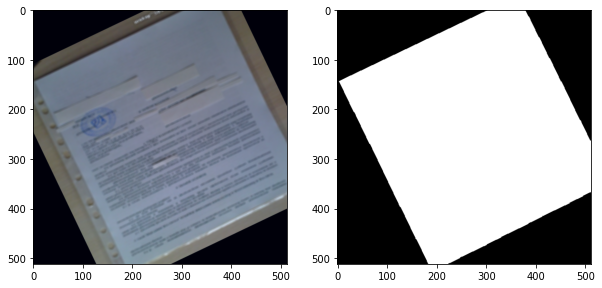

0.8654461 -0.02864629
1.0 0.0


In [ ]:
# Plot image and its mask
ind = 1

print(torch.max(test_data['I'][ind]), torch.min(test_data['I'][ind]))
print(torch.max(test_data['M'][ind]), torch.min(test_data['M'][ind]))
test_img = test_data['I'][ind].permute(1,2,0).numpy()*0.226 + 0.45
test_mask = test_data['M'][ind].permute(1,2,0).numpy()

fig, ax = plt.subplots(1, 2, figsize=(10, 5))

ax[0].imshow(test_img)
ax[1].imshow(test_mask.squeeze(), plt.cm.gray)
plt.show()

print(np.max(test_img), np.min(test_img))
print(np.max(test_mask), np.min(test_mask))

In [ ]:
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')

checkpoint_dir = '/content/drive/MyDrive/experiments/docs_segmentation/u2net/checkpoint/'
vis_dir = '/content/drive/MyDrive/experiments/docs_segmentation/u2net/result/'
LR = 0.0001
EPOCHS = 1500

In [ ]:
torch.cuda.empty_cache()
trainer = DocsTrainer(dataloaders=dataloaders)
trainer.train_model()

Epoch 668 / 1499, Epoch_acc=0.9907, Historical_best_acc=0.9911 (at epoch 468)



In [ ]:
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
net = U2NET(3, 1).to(device)

In [ ]:
checkpoint = torch.load(os.path.join(checkpoint_dir, 'best_ckpt.pt'))
net.load_state_dict(checkpoint['model_state_dict'])

<All keys matched successfully>

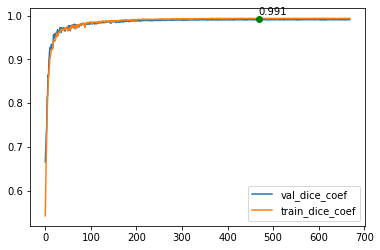

In [ ]:
val_history = checkpoint['val_history']
train_history = checkpoint['train_history']

plt.plot(val_history, label='val_dice_coef')
plt.plot(train_history, label='train_dice_coef')
plt.plot(np.argmax(np.array(val_history)), max(val_history), 'go')
plt.text(np.argmax(np.array(val_history))+0.2, max(val_history)+0.01, str(round(max(val_history),3)))
plt.legend()
plt.show()

## Testing

In [14]:
checkpoint_dir = '/content/drive/MyDrive/experiments/docs_segmentation/u2net/checkpoint/'
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
net = U2NET(3, 1).to(device)

In [15]:
checkpoint = torch.load(os.path.join(checkpoint_dir, 'best_ckpt.pt'))
net.load_state_dict(checkpoint['model_state_dict'])

<All keys matched successfully>

In [22]:
def unit_vector(vector):
    """ Returns the unit vector of the vector """
    return vector / np.linalg.norm(vector)


def angle_between(v1, v2):
    """ Returns the angle in radians between vectors 'v1' and 'v2' """
    v1_u = unit_vector(v1)
    v2_u = unit_vector(v2)
    angle = np.arccos(np.clip(np.dot(v1_u, v2_u), -1.0, 1.0))
    if v2_u[1] < 0:
        angle = 6.28 - angle
    return angle


def get_intersection(line1, line2):
    """ Count intersection of two lines """
    p1, p2 = line1
    p3, p4 = line2

    k1 = (p1[1]-p2[1]) / (p1[0] - p2[0] + 0.1)
    b1 = p1[1] - p1[0]*k1

    k2 = (p3[1]-p4[1]) / (p3[0] - p4[0] + 0.1)
    b2 = p3[1] - p3[0]*k2

    x = (b2 - b1) / (k1 - k2)
    y = x * k1 + b1

    return int(x), int(y)


def rotate(p, origin=(0, 0), degrees=0):
    """ Rotate coordinates to some angle """
    angle = np.deg2rad(degrees)
    R = np.array([[np.cos(angle), -np.sin(angle)],
                  [np.sin(angle), np.cos(angle)]])
    o = np.atleast_2d(origin)
    p = np.atleast_2d(p)
    return np.squeeze((R @ (p.T - o.T) + o.T).T)


def get_max_hw(points):
    """ Calculate maximum height and width from four clockwise sorted (start top left) points """
    w1 = np.linalg.norm(points[0] - points[1])
    w2 = np.linalg.norm(points[2] - points[3])
    h1 = np.linalg.norm(points[0] - points[2])
    h2 = np.linalg.norm(points[1] - points[3])
    hf = int(np.max([h1, h2]))
    wf = int(np.max([w1, w2]))

    return hf, wf


def sort_points(points):
    """
    Sort four points by its distance from top left corner
    Input:
        - points - four points [[x,y],...]
    Output:
        - points - sorted points
    """

    points = points.reshape(4, 2)

    distances = [np.sqrt(np.power(point[0], 2) + np.power(point[1], 2)) for point in points]
    dist_ind = np.argsort(distances)
    points = points[dist_ind]

    # Fix 2-nd and 3-d points
    if points[2][1] < points[1][1]:
        points = points[[0, 2, 1, 3]]

    # Swap the last two points to create correct polygon
    points = points[[0, 1, 3, 2]]

    return points


def fix_points(i, points, h_p, w_p):
    """
    Fix cases where points don't align to boundaries
    Input:
        - i - number of quarter
        - points - four points [[x,y],...]
        - h_p - height of quarter
        - w_p - width of quarter
    Output:
        - points - fixed points
    """

    if i == 0:
        points[1][0] = w_p
        points[3][1] = h_p
        points[2] = np.array([w_p, h_p])

    elif i == 1:
        points[0][0] = 0.
        points[3] = np.array([0., h_p])
        points[2][1] = h_p

    elif i == 2:
        points[0][1] = 0.
        points[1] = np.array([w_p, 0.])
        points[2][0] = w_p

    elif i == 3:
        points[0] = np.array([0., 0.])
        points[1][1] = 0.
        points[3][0] = 0.

    return np.array(points).astype(np.int32)


def get_intersection_point(points, center, degrees):
    """ Calculate intersection point related to each quarter """
    # Prepare coordinated for angle calculation
    point_vectors = np.array(
        [[point[0][0], center[1] * 2 - point[0][1]] for point in points])  # Reverse height coordinates
    point_vectors = [point - center for point in point_vectors]  # Center coordinates
    # Rotate coordinates for quarter quality
    point_vectors = [rotate(point, origin=(0, 0), degrees=degrees) for point in point_vectors]
    start_vector = np.array([1., 0.])  # Vector relative to which the angle is calculated
    thetas = [angle_between(start_vector, np.array(point_vector)) for point_vector in point_vectors]  # Angles
    sorted_thetas = np.argsort(thetas)  # Sort angles counterclockwise
    points_cur = points[sorted_thetas].squeeze()  # Sort points by angles
    first_line = [points_cur[0], points_cur[1]]
    second_line = [points_cur[-2], points_cur[-3]]

    int_point = get_intersection(first_line, second_line)

    return int_point, points_cur


def sort_clockwise(i, points, h_p, w_p):
    """
    Get intersection of first from start and third from end lines and
    sort points as [tl, tr, bt, bl]
    Input:
        - i - number of quarter
        - points - mask approximation points
        - h_p - quarter height
        - w_p - quarter width
    Output:
        - coords - four sorted coordinates [tl, tr, bt, bl]
    """

    center = np.array([w_p // 2, h_p // 2])  # Center of quarter

    if i == 0:
        int_point, points_cur = get_intersection_point(points, center, 0)
        # Write coordinates relative to it's quarter
        coords = [int_point, points_cur[0], points_cur[-1], points_cur[-2]]

    elif i == 1:
        int_point, points_cur = get_intersection_point(points, center, 90)
        # Write coordinates relative to it's quarter
        coords = [points_cur[-2], int_point, points_cur[0], points_cur[-1]]

    elif i == 2:
        int_point, points_cur = get_intersection_point(points, center, -90)
        # Write coordinates relative to it's quarter
        coords = [points_cur[0], points_cur[-1], points_cur[-2], int_point]

    elif i == 3:
        int_point, points_cur = get_intersection_point(points, center, -180)
        # Write coordinates relative to it's quarter
        coords = [points_cur[-1], points_cur[-2], int_point, points_cur[0]]

    return coords


def process_quarters(parts, start_epsilon):
    '''
    Approximate quarter masks by four points
    Input:
        - parts - quarters [tl, tr, bl, br]
        - start_epsilon - epsilon for start approximation
    Output:
        - new_parts - approximated quarters [tl, tr, bl, br]
    '''
    new_parts = []

    for i, part in enumerate(parts):
        h_p, w_p = part.shape[0], part.shape[1]
        part_area = h_p * w_p
        # Get main contour of quarter
        p_contours, hierarchy = cv2.findContours(part, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        max_cnt_p = p_contours[np.argmax([cv2.contourArea(contour) for contour in p_contours])]
        # Approximate contour
        peri = cv2.arcLength(max_cnt_p, True)
        approx = cv2.approxPolyDP(max_cnt_p, start_epsilon * peri, True).astype(np.int32)

        # If after approximation contour can't be discribed by 4 lines
        if len(approx) > 4:
            # Check what is more valuable convexity defects correction or approximation cutting
            hull = cv2.convexHull(max_cnt_p, returnPoints=True)
            tmp_part = cv2.fillPoly(np.zeros_like(part), [hull.squeeze()], [255])
            tmp_part_approx = cv2.fillPoly(np.zeros_like(part), [approx], [255])
            # Area of convexity defects correction
            unintersect_area = np.sum(np.clip(np.abs(part - tmp_part), 0., 1.)) / part_area
            # Area of approximation cutting
            unintersect_area_approx = np.sum(np.clip(part - tmp_part_approx, 0., 1.)) / part_area
            # print(unintersect_area, unintersect_area_approx)
            if unintersect_area > unintersect_area_approx:
                peri = cv2.arcLength(hull, True)
                approx_h = cv2.approxPolyDP(hull, 0.005 * peri, True).astype(np.int32)
            else:
                approx_h = cv2.approxPolyDP(max_cnt_p, 0.02 * peri, True).astype(np.int32)

            if len(approx_h) > 4:
                # Get intersection of first from start and third from end lines
                s_approx = sort_clockwise(i, approx_h, h_p, w_p)  # Sort points [tl, tr, bt, bl]
                f_approx = fix_points(i, s_approx, h_p, w_p)  # Fix points alignment to boundaries
                tmp_part = cv2.fillPoly(np.zeros_like(part), [f_approx], [255])
                new_parts.append(tmp_part)

            else:
                s_approx = sort_points(approx_h)  # Sort points [tl, tr, bt, bl]
                f_approx = fix_points(i, s_approx, h_p, w_p)  # Fix points alignment to boundaries
                tmp_part = cv2.fillPoly(np.zeros_like(part), [f_approx], [255])
                new_parts.append(tmp_part)

        else:

            s_approx = sort_points(approx)  # Sort points [tl, tr, bt, bl]
            f_approx = fix_points(i, s_approx, h_p, w_p)  # Fix points alignment to boundaries
            tmp_part = cv2.fillPoly(np.zeros_like(part), [f_approx], [255])
            new_parts.append(tmp_part)

    return new_parts


def get_list_coords(mask):
    """
    Determine the four approximate coordinates of the document
    Input:
        - mask - grayscale image of document mask
    Output:
        - cut_coords - four coordinates sorted clockwise starting from top left corner
    """

    # Get main contour of mask
    h, w = mask.shape[0], mask.shape[1]
    contours, hierarchy = cv2.findContours(mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    max_cnt = contours[np.argmax([cv2.contourArea(contour) for contour in contours])]
    # Get four quarters from main contour for better defects processing
    test_img = cv2.fillPoly(np.zeros_like(mask), [max_cnt], [255])
    tl = test_img[:h // 2, :w // 2].copy()
    tr = test_img[:h // 2, w // 2:].copy()
    bl = test_img[h // 2:, :w // 2].copy()
    br = test_img[h // 2:, w // 2:].copy()
    parts = [tl, tr, bl, br]

    new_parts = process_quarters(parts.copy(), 0.01)

    # Connect all quarters together
    full_mask = np.concatenate((np.concatenate((new_parts[0], new_parts[1]), axis=1),
                                np.concatenate((new_parts[2], new_parts[3]), axis=1)), axis=0)
    # Approximate final contour
    f_contours, hierarchy = cv2.findContours(full_mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    peri = cv2.arcLength(f_contours[0], True)
    approx_f = cv2.approxPolyDP(f_contours[0], 0.1 * peri, True).astype(np.int32)

    # Sort points [tl, tr, bt, bl]
    coords = sort_points(approx_f[:4].reshape(4, 2))
    tmp_mask = cv2.fillPoly(np.zeros_like(mask), [coords], [255])
    tmp_mask_cut_area = np.sum(np.clip(mask - tmp_mask, 0., 1.)) / np.sum(np.clip(mask, 0., 1.))
    # If after processing main part of the mask was cutted, then repeat it more accurate
    if tmp_mask_cut_area > 0.05:
        # print(tmp_mask_cut_area)
        new_parts = process_quarters(parts.copy(), 0.001)

        # Connect all quarters together
        full_mask = np.concatenate((np.concatenate((new_parts[0], new_parts[1]), axis=1),
                                    np.concatenate((new_parts[2], new_parts[3]), axis=1)), axis=0)
        # Approximate final contour
        f_contours, hierarchy = cv2.findContours(full_mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        peri = cv2.arcLength(f_contours[0], True)
        approx_f = cv2.approxPolyDP(f_contours[0], 0.1 * peri, True).astype(np.int32)

        # Sort points [tl, tr, bt, bl]
        coords = sort_points(approx_f[:4].reshape(4, 2))

    cut_coords = [coords[0], coords[1], coords[3], coords[2]]

    return cut_coords


def cut_doc(model, device, file_path):
    """ Process photo of document and cut it """
    INPUT_SHAPE = 512

    img_st = cv2.imread(file_path)
    h, w = img_st.shape[0], img_st.shape[1]
    # Reshape for neural net input size
    img = cv2.resize(img_st[:, :, ::-1], (INPUT_SHAPE, INPUT_SHAPE), interpolation=cv2.INTER_AREA)

    # Prepare image for prediction
    std = np.array([0.229, 0.224, 0.225]).T
    mean = np.array([0.485, 0.456, 0.406]).T
    img = (img / 255 - mean) / std

    # Generate set of vertically and horizontally flipped images for better prediction accuracy
    imgs = np.array([img, img[:, ::-1, :].copy(), img[::-1, :, :].copy(), img[::-1, ::-1, :].copy()])

    imgs = torch.FloatTensor(imgs).permute(0, 3, 1, 2).to(device)  # Convert images to torch tensor
    d0, d1, d2, d3, d4, d5, d6 = model(imgs)  # Predict
    masks_0 = d0.detach().cpu().numpy().squeeze()

    # Postprocessing
    mask = (masks_0[0] + masks_0[1][:, ::-1] + masks_0[2][::-1, :] + masks_0[3][::-1, ::-1]) / 4
    _, mask = cv2.threshold(np.uint8(mask * 255), 150, 255, cv2.THRESH_BINARY)
    mask = cv2.resize(mask.astype(np.uint8), (w, h), interpolation=cv2.INTER_CUBIC)

    cut_coords = get_list_coords(mask)  # Get coordinates for document

    # Prepare coordinates for perspective transformation
    pts1 = np.float32(cut_coords)
    hf, wf = get_max_hw(pts1)  # Height and width for image after perspective transformation
    pts2 = np.float32([[0, 0], [wf, 0], [0, hf], [wf, hf]])
    M = cv2.getPerspectiveTransform(pts1, pts2)  # Get transformation matrix
    document = cv2.warpPerspective(img_st, M, (wf, hf))

    fig, ax = plt.subplots(1,3, figsize=(18, 7))
    ax[0].imshow(img_st[:, :, ::-1])
    for point in cut_coords:
        ax[0].plot(point[0], point[1], 'ro')
    ax[1].imshow(cv2.drawContours(mask, [np.array([cut_coords[0], cut_coords[1], cut_coords[3], cut_coords[2]])], 0, [127], 5), plt.cm.gray)
    ax[2].imshow(document[:, :, ::-1])
    plt.show()

    return document

In [20]:
def predict(files_dir, pred_path):
    '''
    Cut the document from photo and save as .pdf
    Input:
        - file_path - list of filenames
        - pred_path - the absolute path for cut out image file
    Output:
        - pred_path - the absolute path for cut out image file
    '''

    document_height = 1500

    cutted_docs = []
    if type(files_dir) == str:
        filenames = sorted(os.listdir(files_dir))
    else:
        filenames = files_dir

    for ind, filename in enumerate(filenames):
        print(ind)
        document = cut_doc(net, device, filename)
        scale = document.shape[0] / document_height
        new_w, new_h = int(document.shape[1] / scale), int(document.shape[0] / scale)
        if scale > 1.0:
            document = cv2.resize(document, (new_w, new_h), interpolation=cv2.INTER_AREA)
        elif scale < 1.0:
            document = cv2.resize(document, (new_w, new_h), interpolation=cv2.INTER_CUBIC)

        doc_image = Image.fromarray(document[:, :, ::-1])
        doc_image = doc_image.convert('RGB')
        cutted_docs.append(doc_image)

    if len(cutted_docs) > 1:
        cutted_docs[0].save(pred_path, save_all=True, append_images=cutted_docs[1:])
    else:
        cutted_docs[0].save(pred_path)

    return pred_path

0


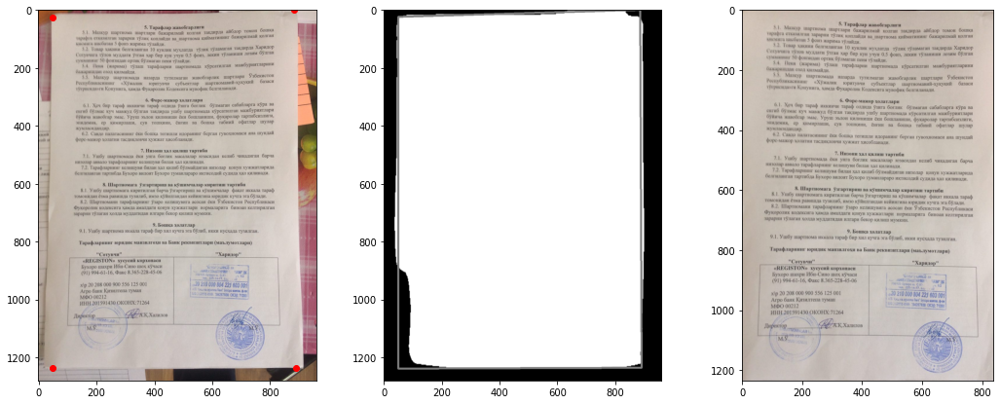

1


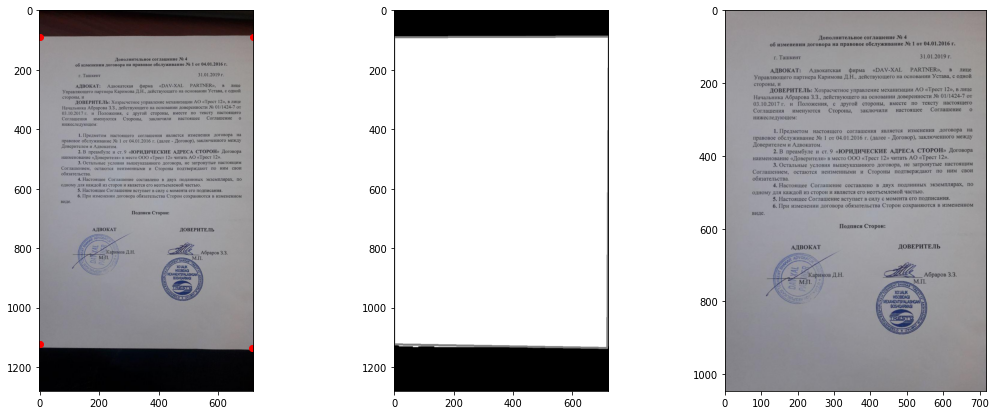

2


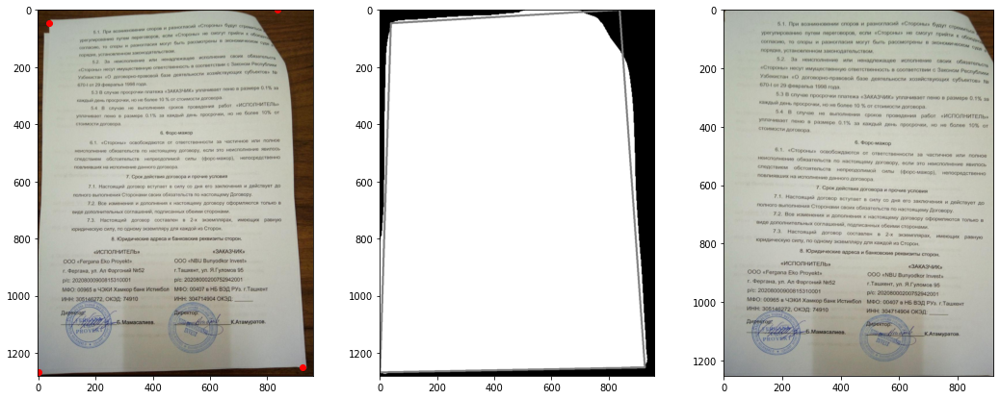

3


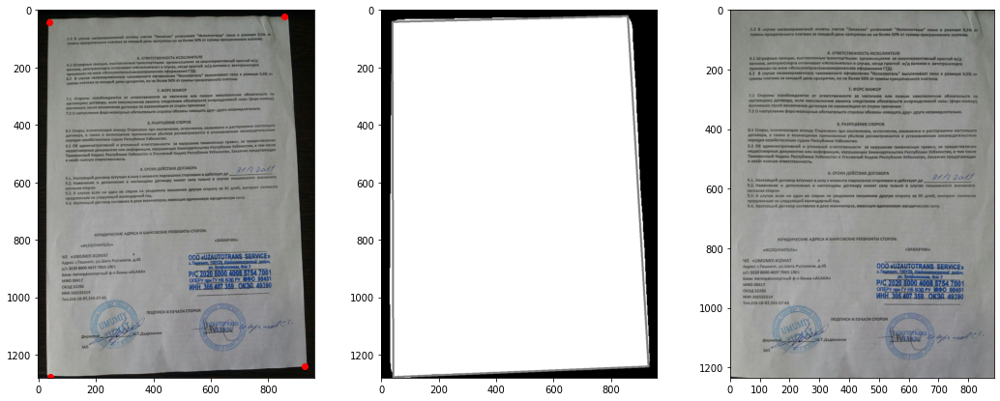

4


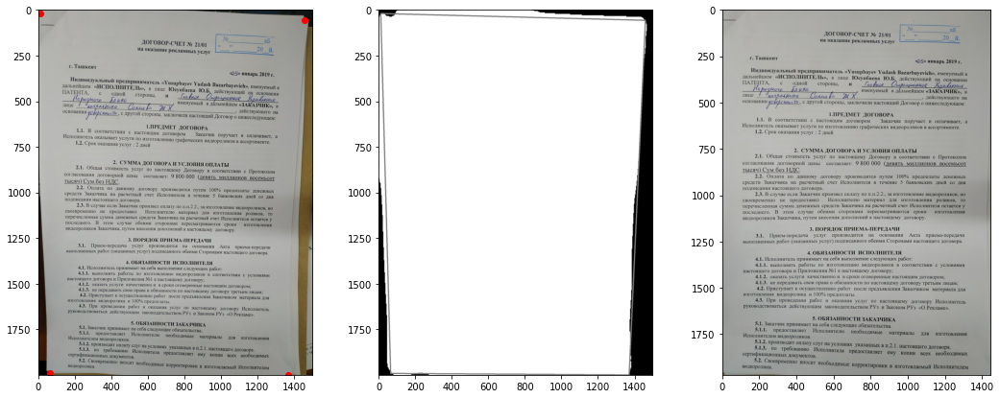

5


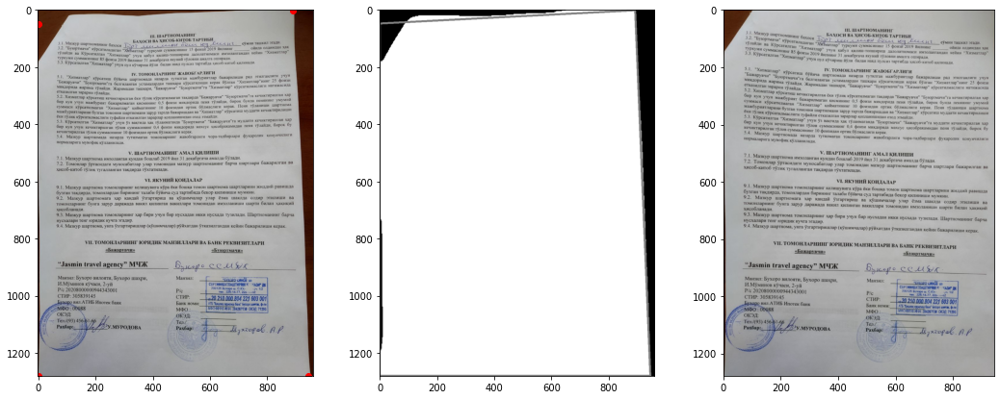

6


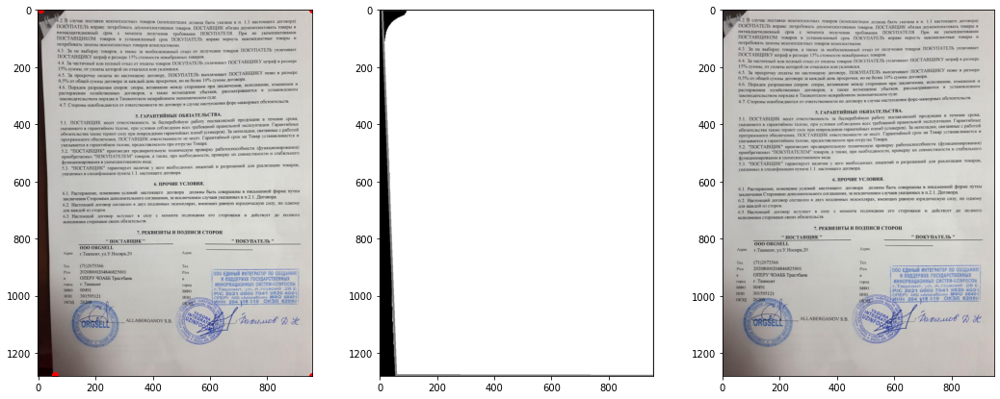

7


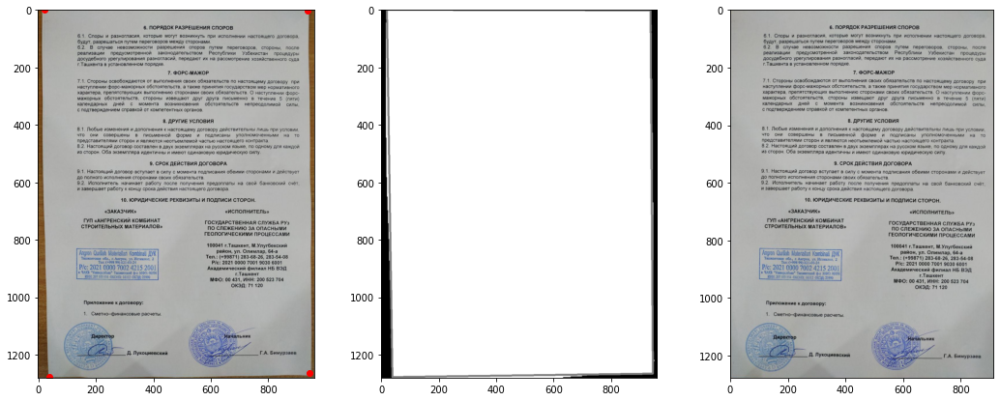

8


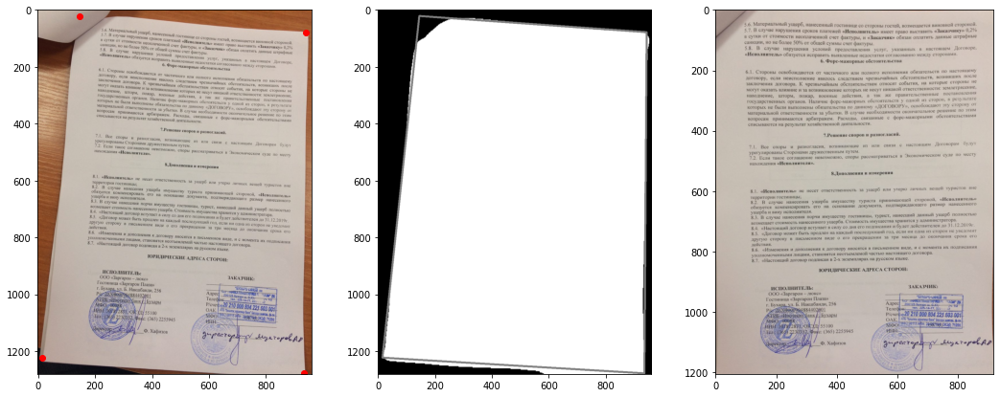

9


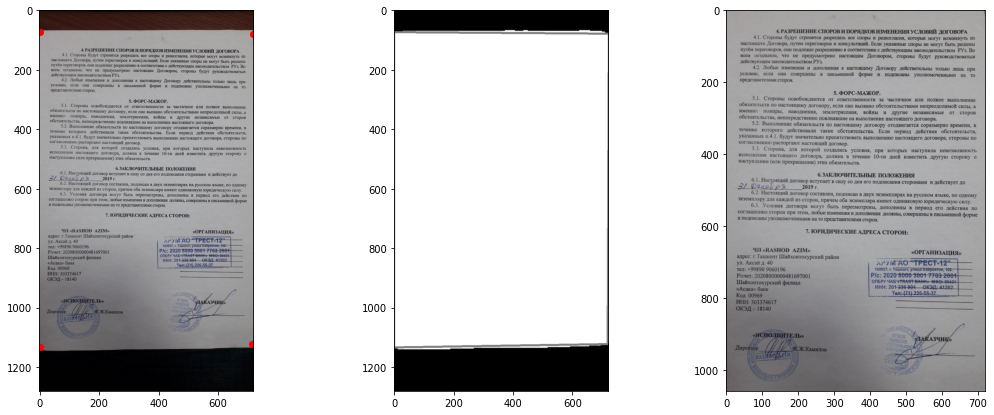

/content/drive/MyDrive/experiments/docs_segmentation/results/results/199_1.pdf
0


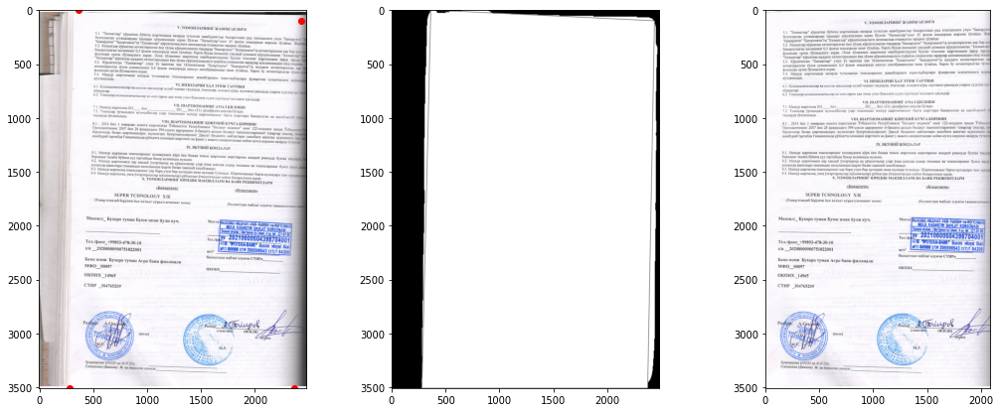

1


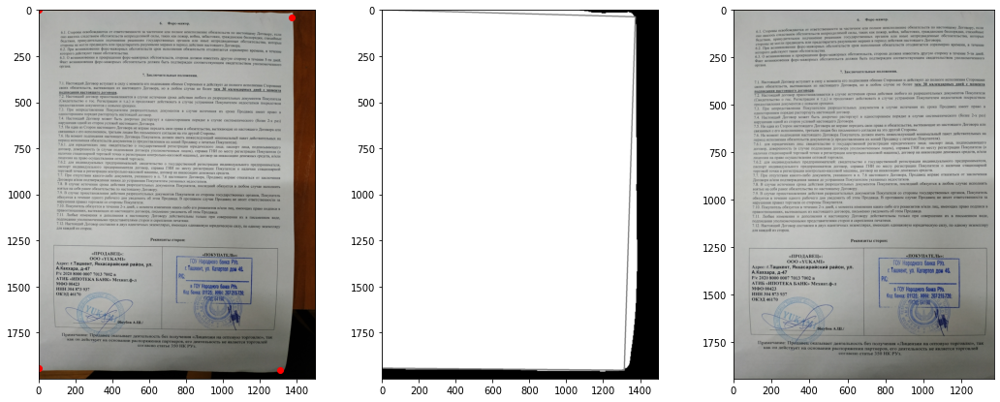

2


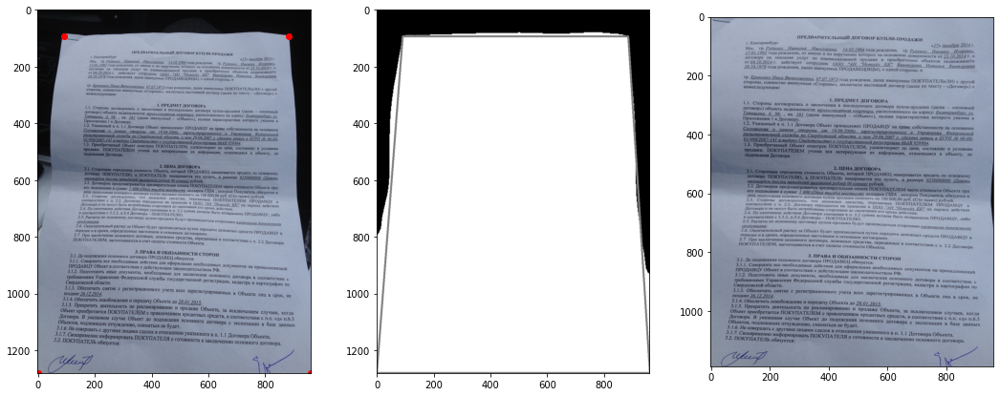

3


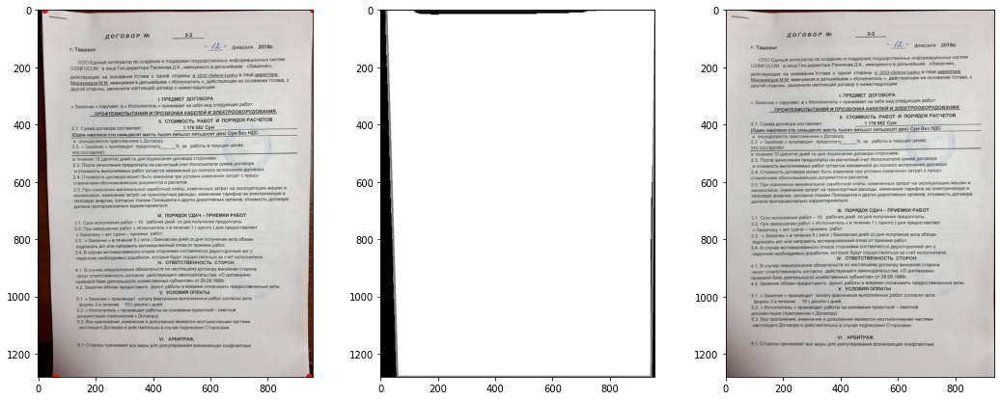

4


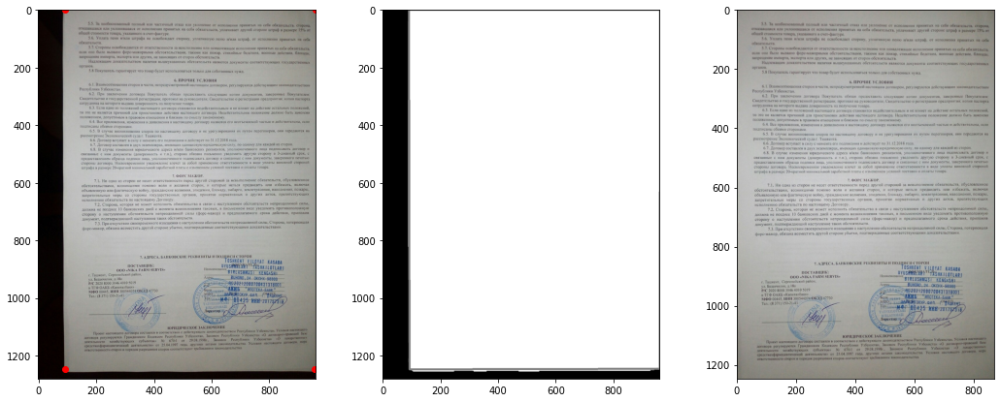

5


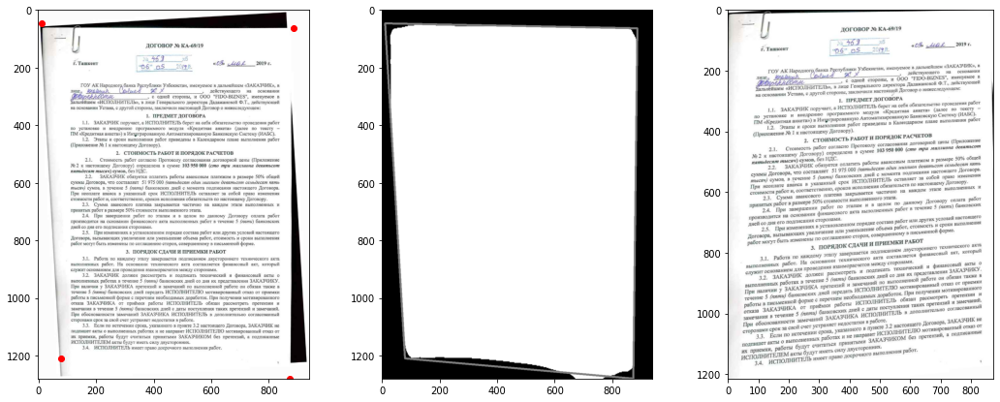

6


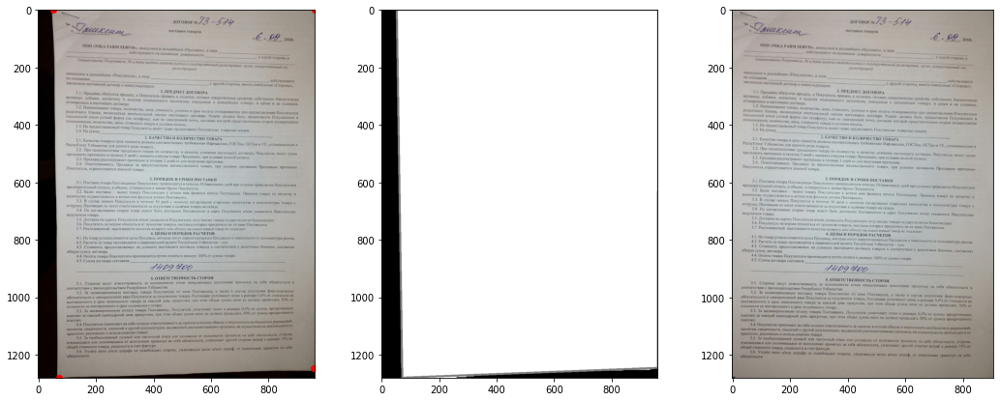

7


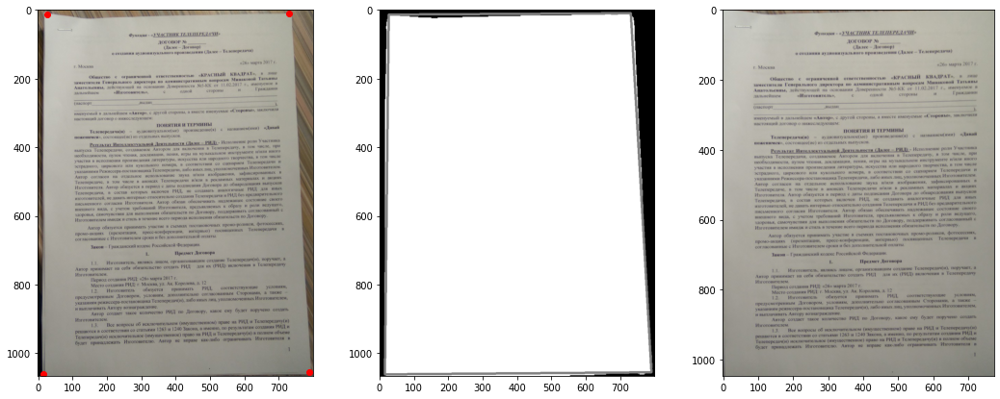

8


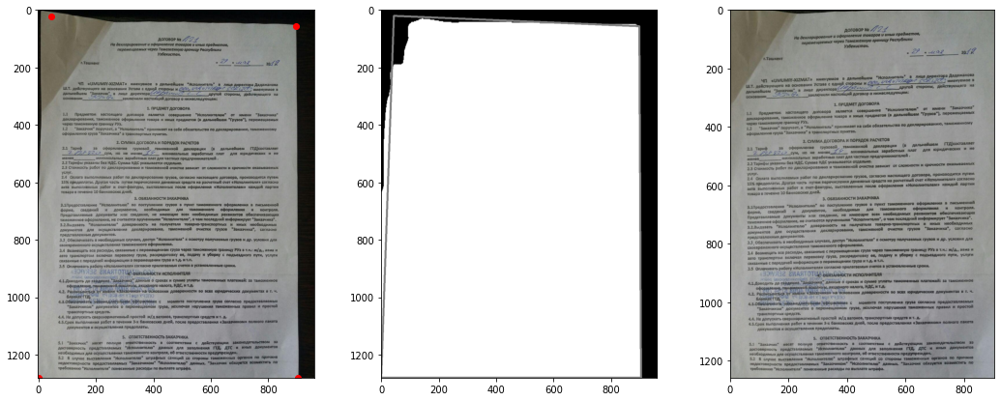

9


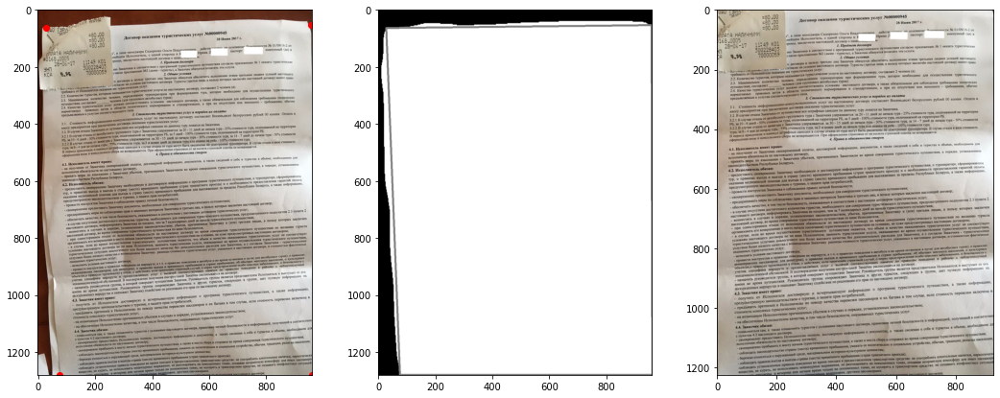

/content/drive/MyDrive/experiments/docs_segmentation/results/results/209_1.pdf
0


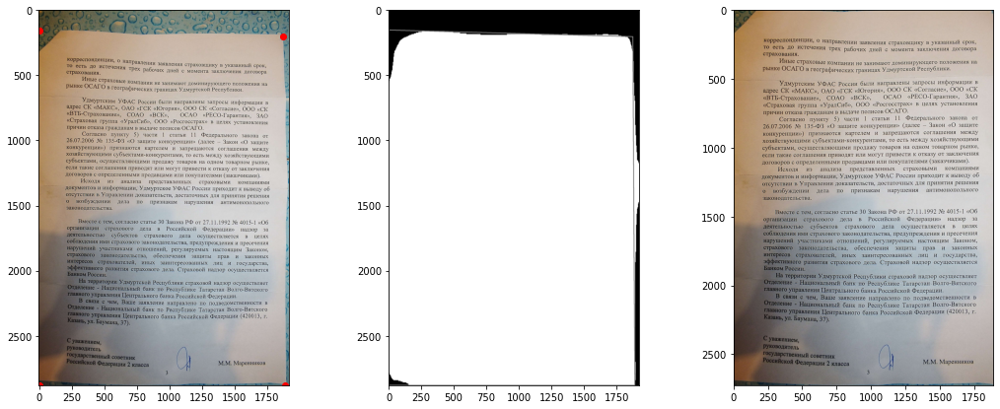

1


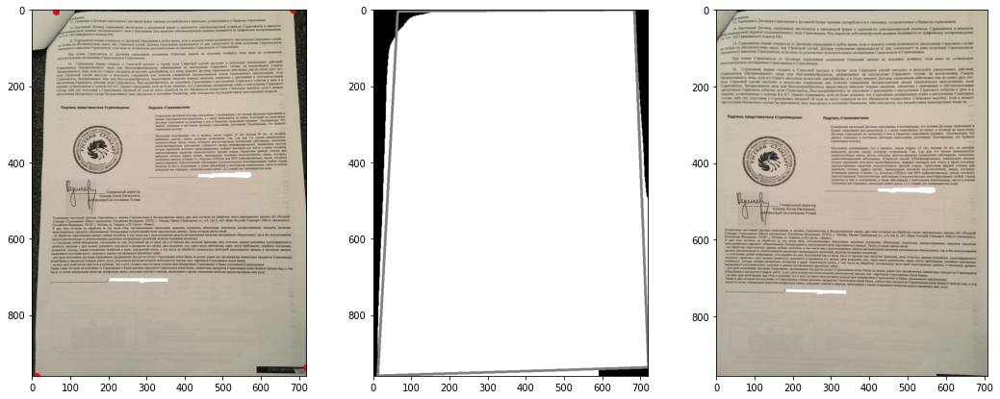

2


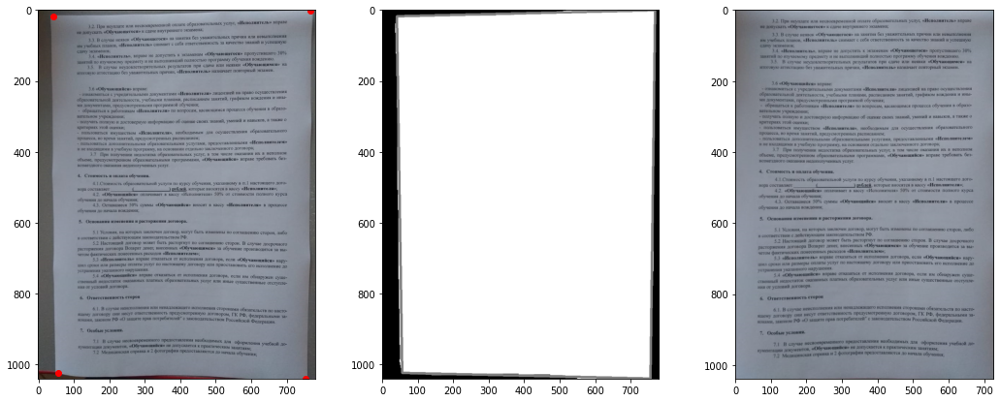

3


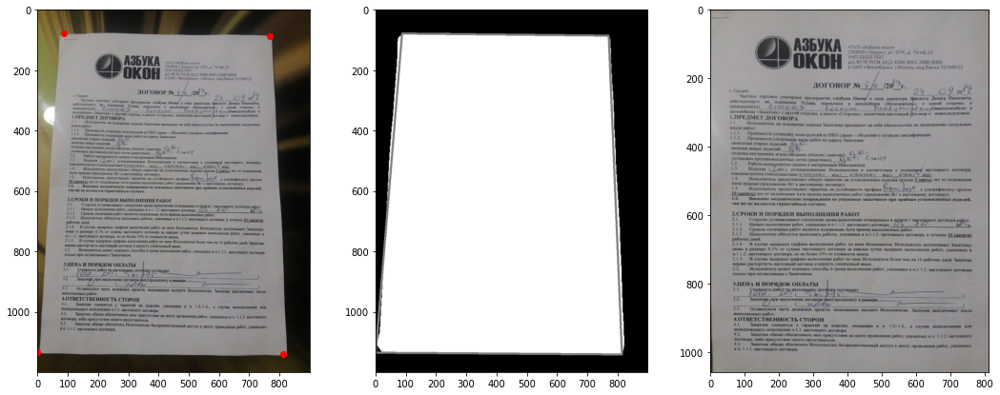

4


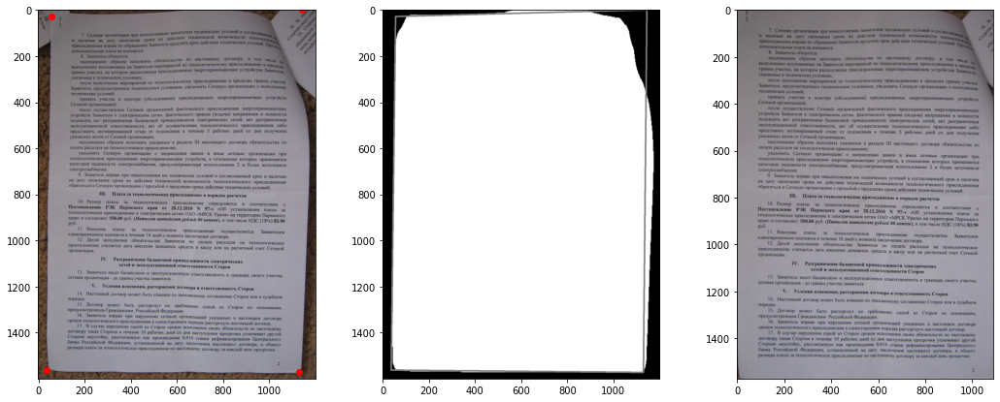

5


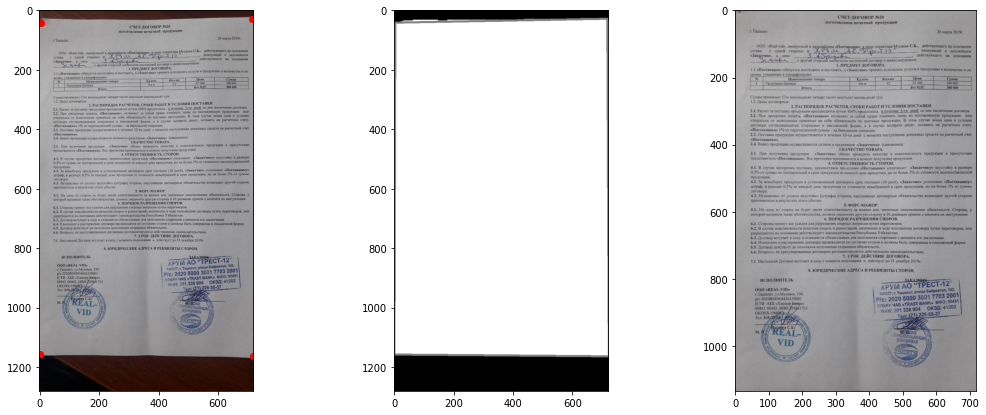

6


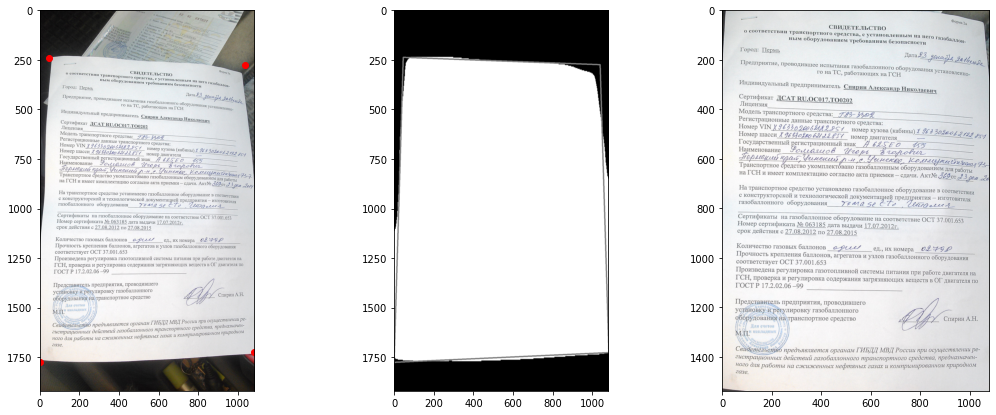

7


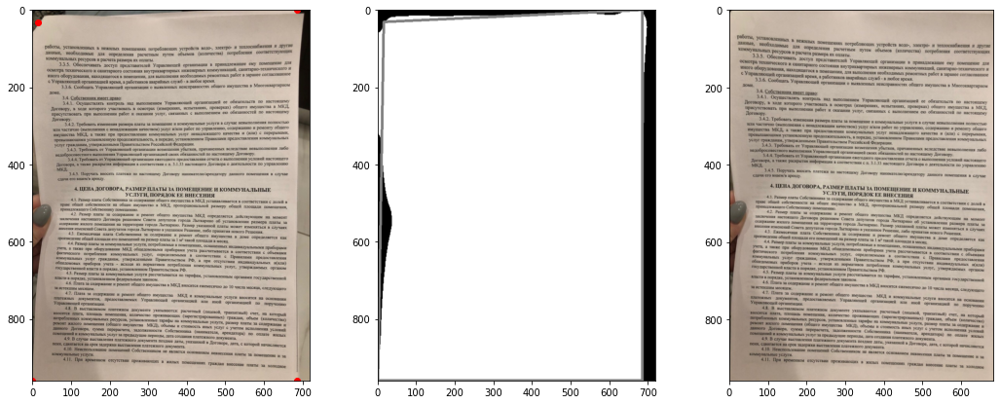

8


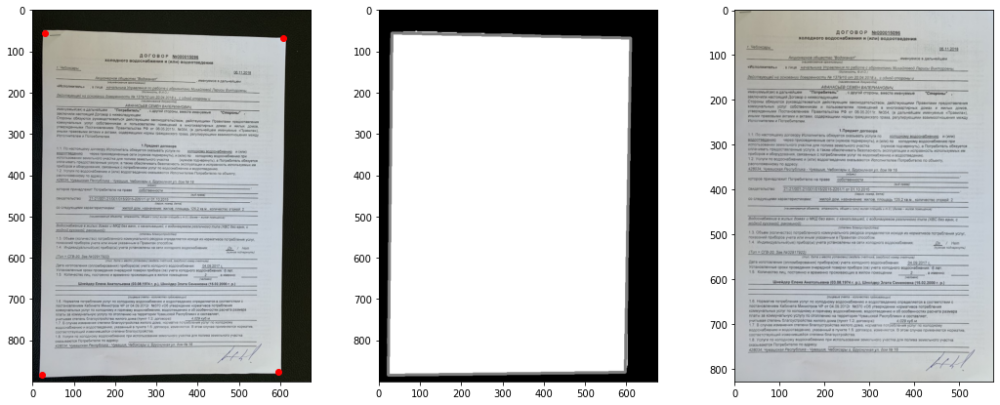

9


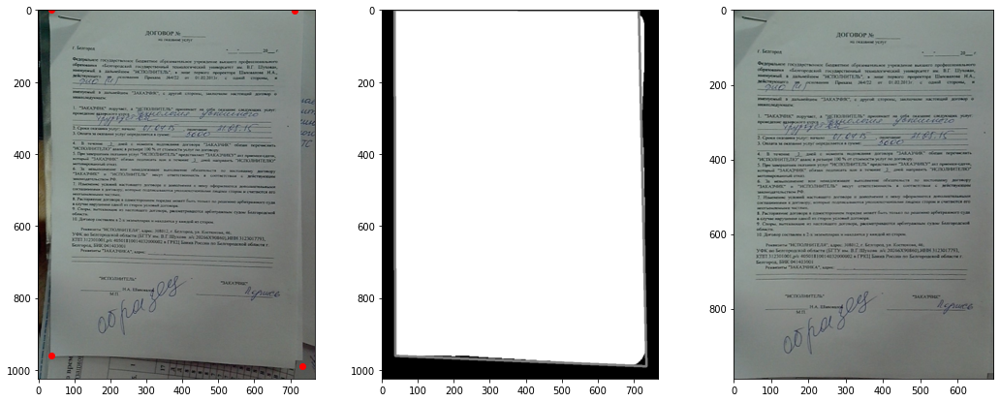

/content/drive/MyDrive/experiments/docs_segmentation/results/results/219_1.pdf
0


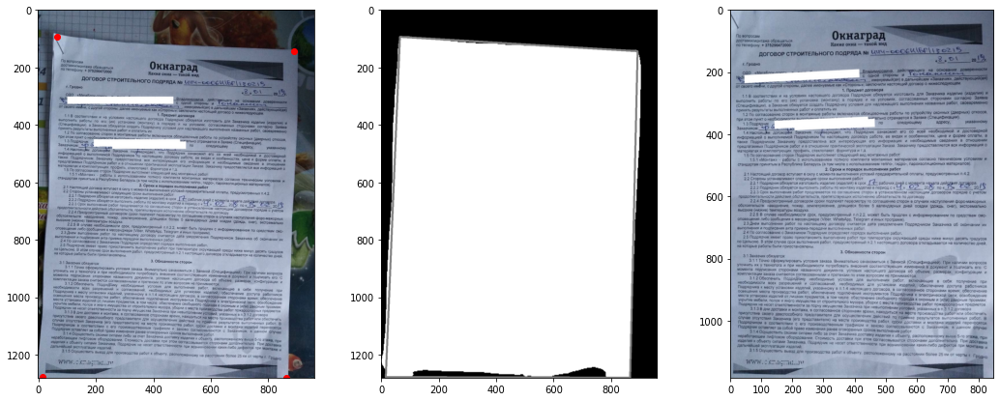

1


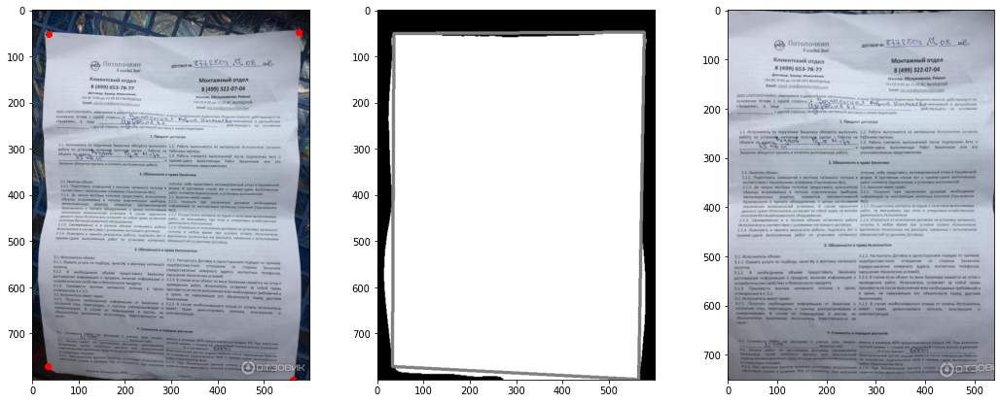

2


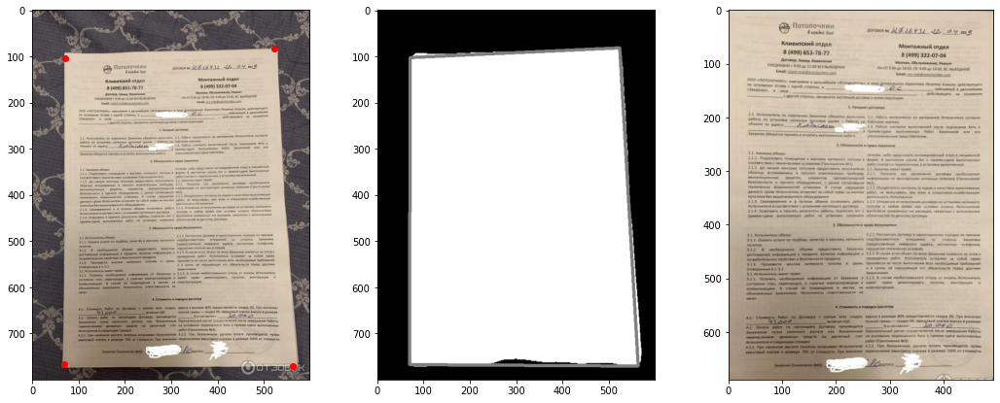

3


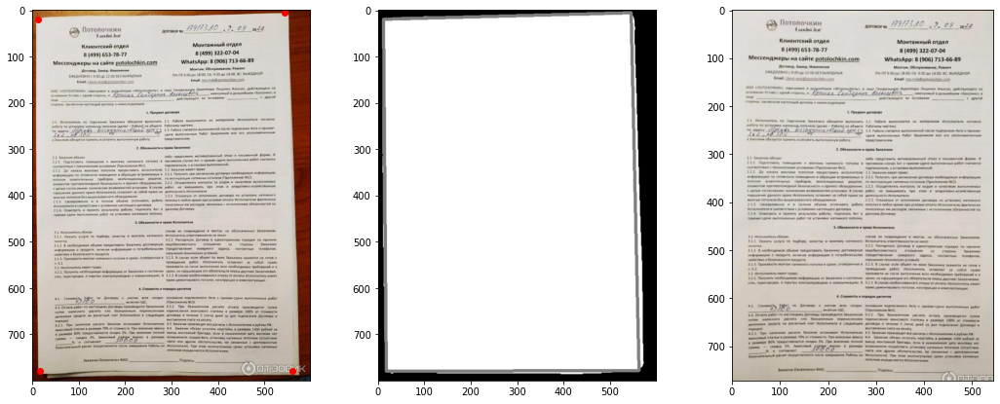

4


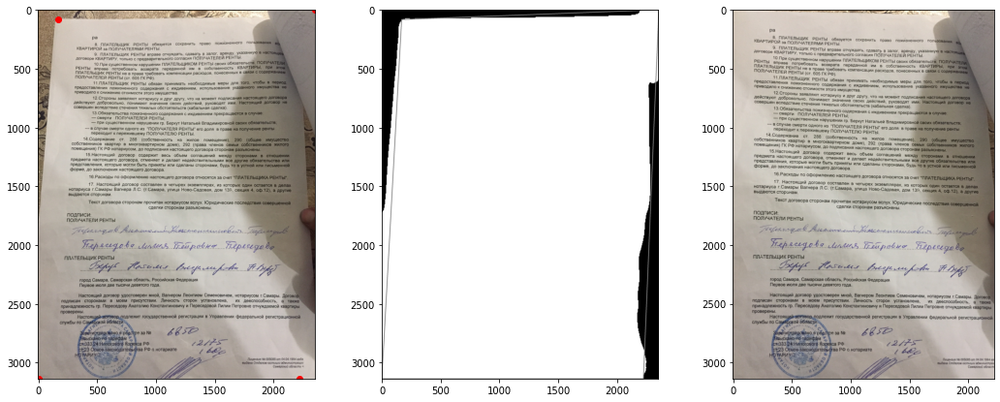

5


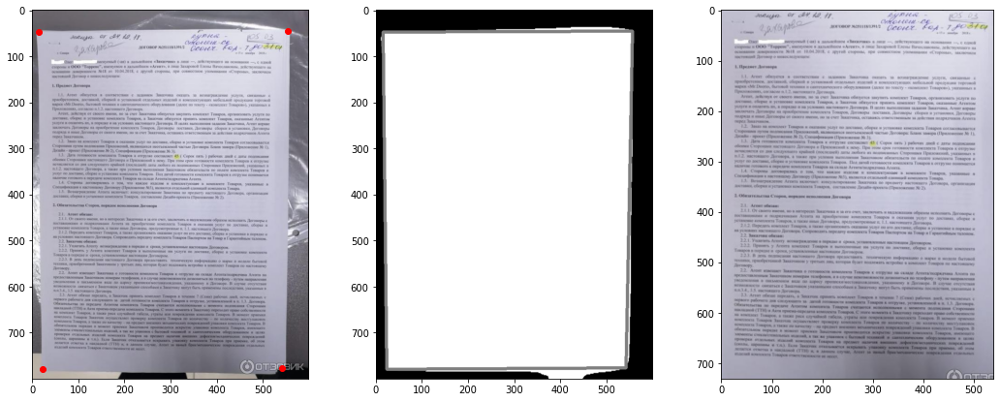

6


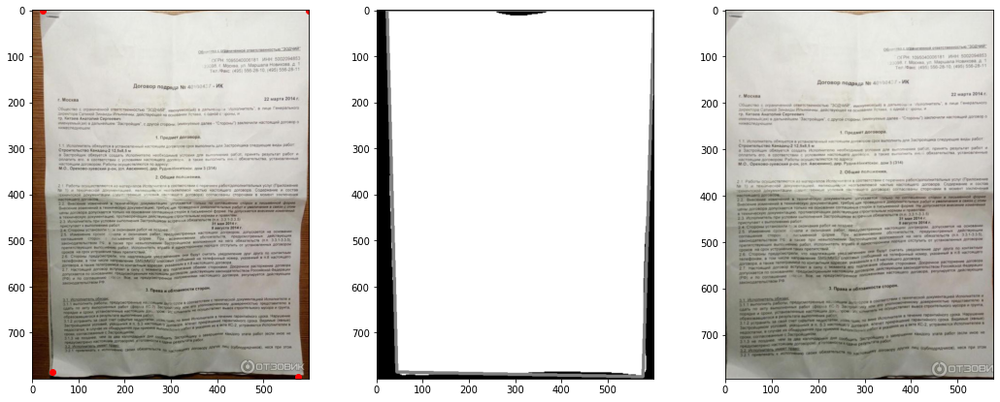

7


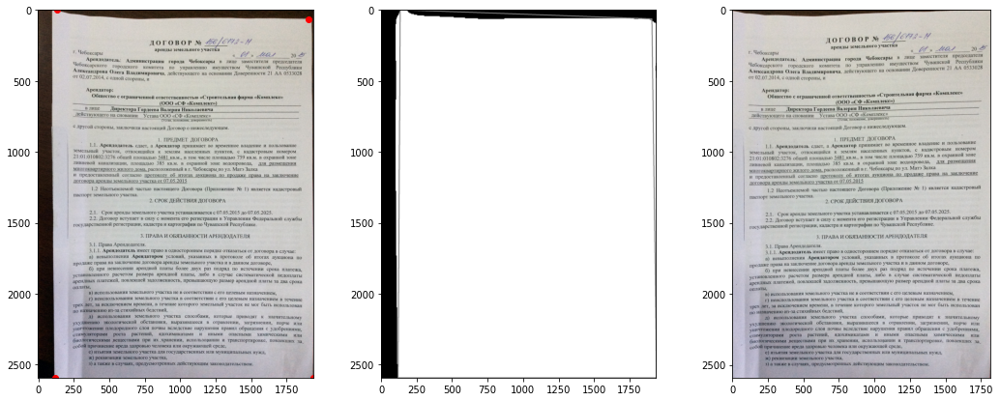

8


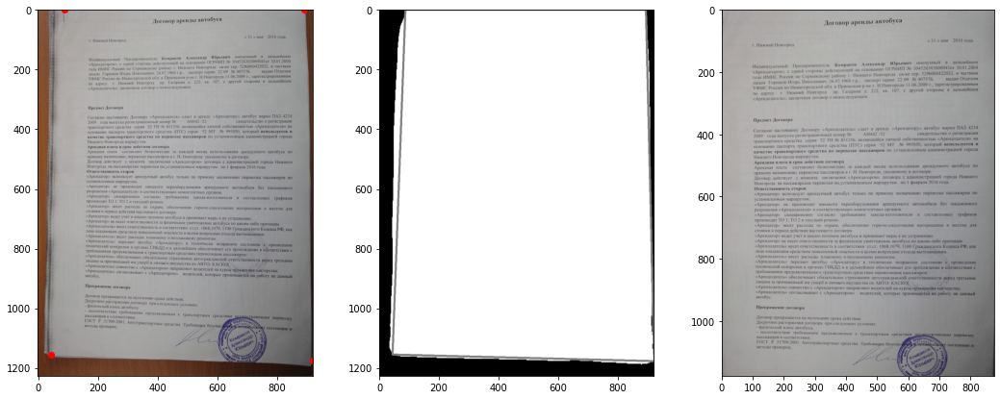

9


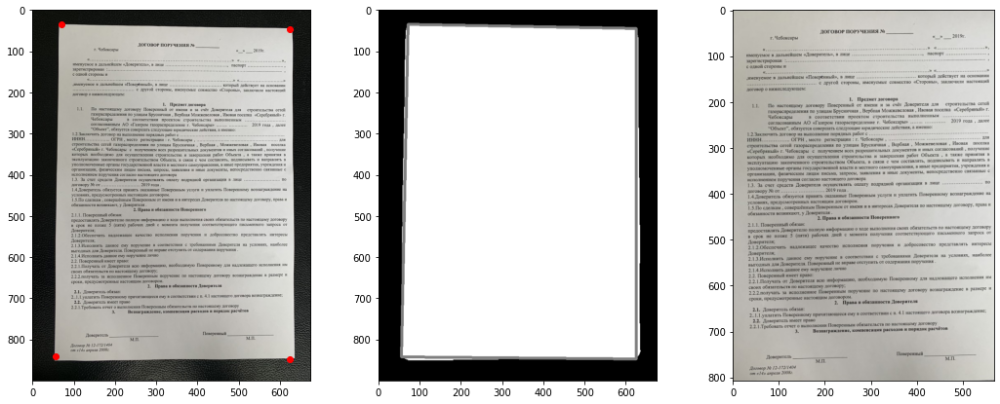

/content/drive/MyDrive/experiments/docs_segmentation/results/results/229_1.pdf
0


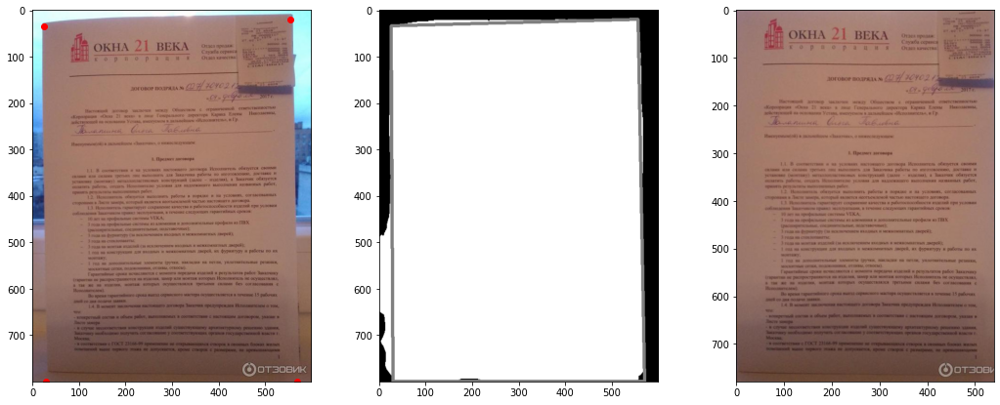

1


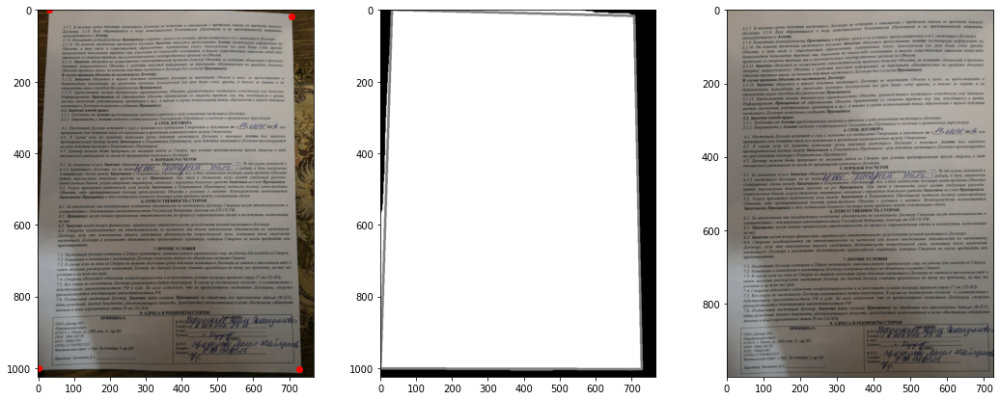

2


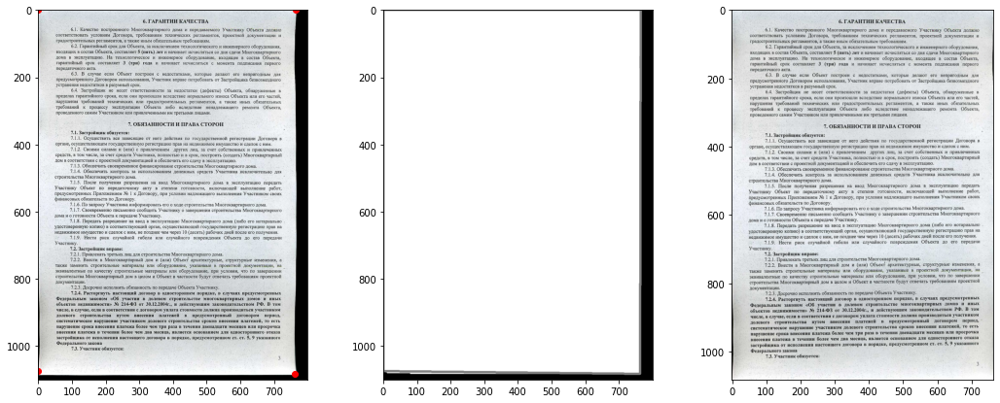

3


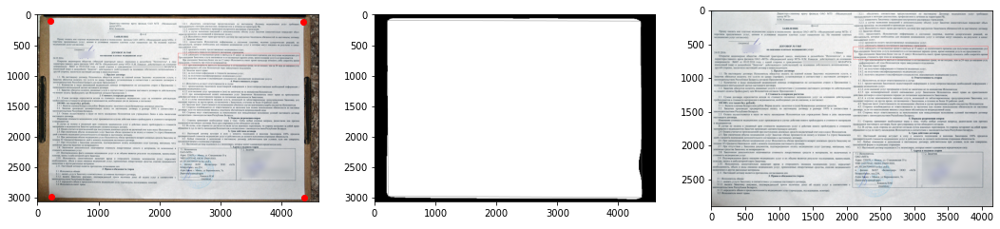

4


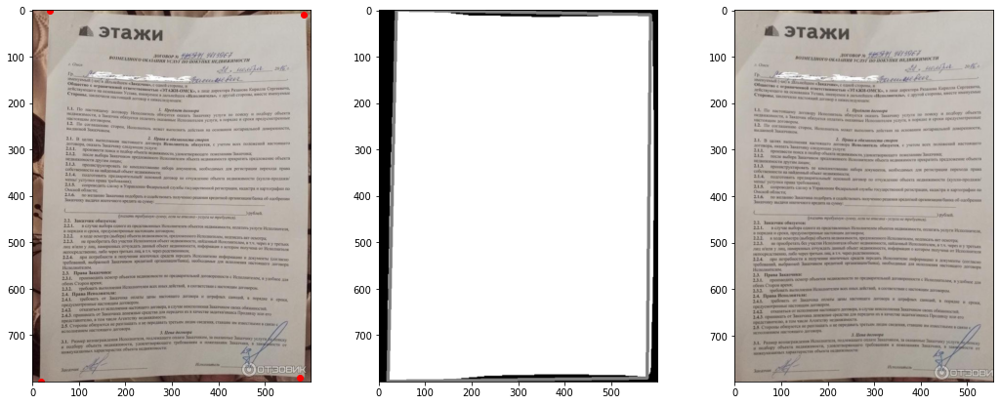

5


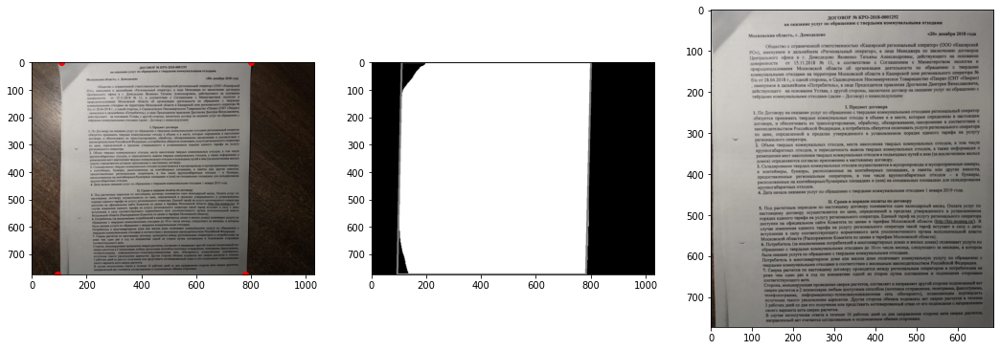

6


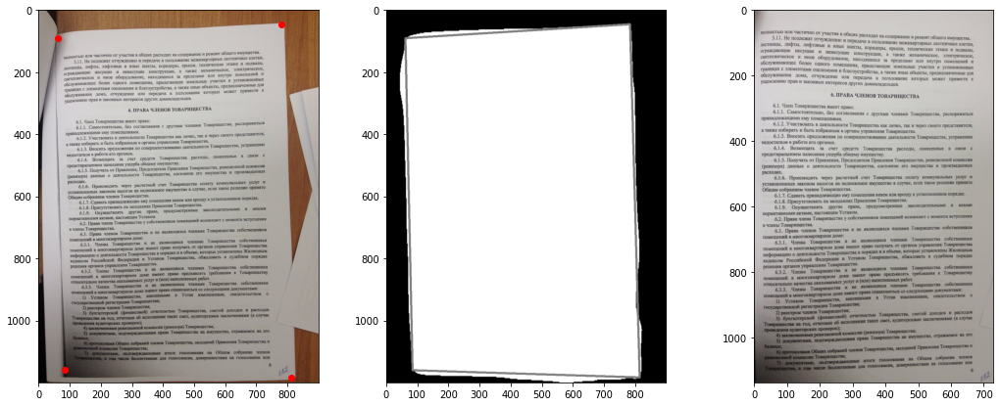

7


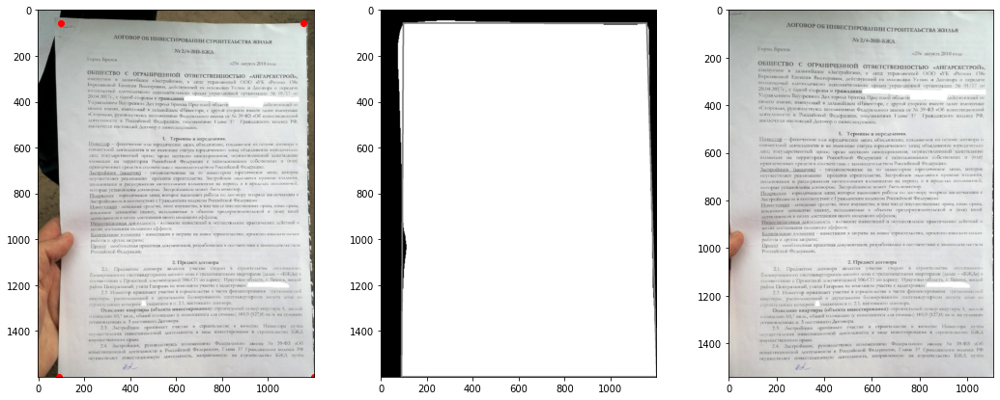

8


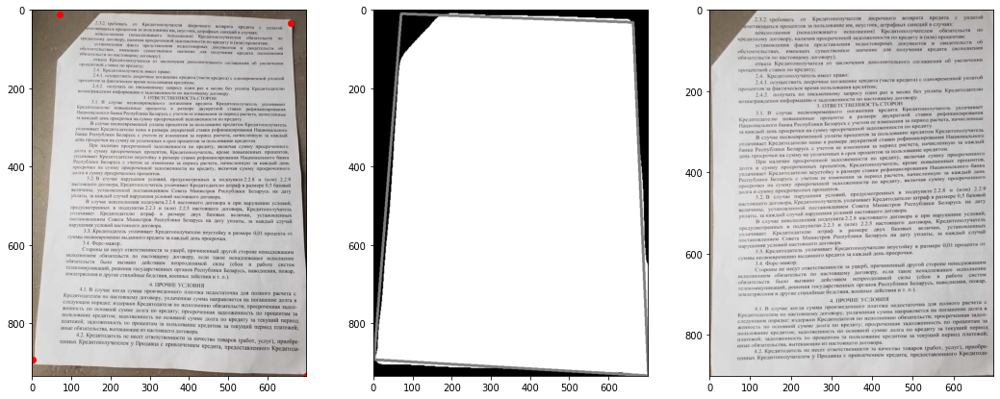

9


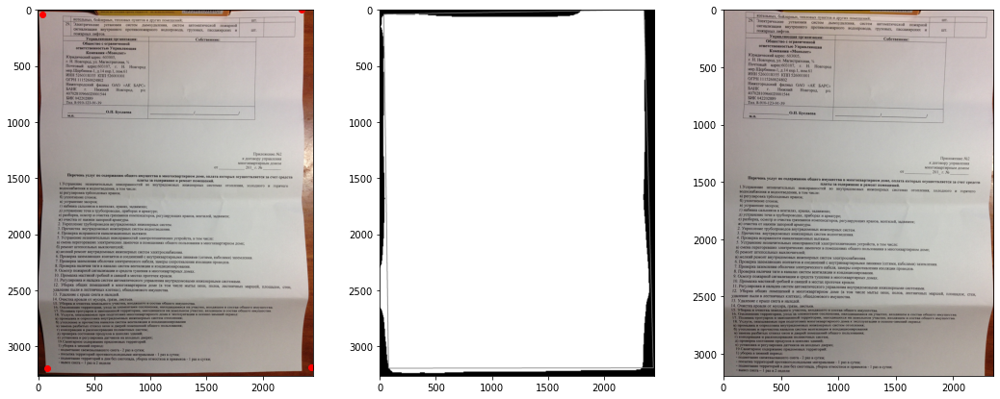

/content/drive/MyDrive/experiments/docs_segmentation/results/results/239_1.pdf


In [23]:
for ind in val_indices.squeeze()[::10]:
    files_dir = [os.path.join(images_dir, str(index)+'.jpg') for index in range(ind, ind+10)]
    pred_path = f'/content/drive/MyDrive/experiments/docs_segmentation/results/results/{ind}_1.pdf'
    pred_path = predict(files_dir, pred_path)
    print(pred_path)